## Part 1: Summary of features

In [2]:
# Import relevant libraries

import pandas as pd
import numpy as np
pd.set_option('max_rows', 15)
pd.plotting.register_matplotlib_converters()
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
print("Setup complete.")

Setup complete.


In [3]:
# Import the dataset and examine the first 5 rows

diabetes_data_path = "../cmp 7023/DiabetesClassificationDataset2022.csv"

diabetes_df = pd.read_csv(diabetes_data_path)

diabetes_df.head()

,encounter_id,hospital_id,gender,ethnicity,age,elective_surgery,height,weight,bmi,readmission_status,...,map_apache,aids,cirrhosis,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,ventilated_apache,diabetes_mellitus
0,214826,118,M,Caucasian,68.0,0,180.3,73.9,22.732803,0,...,40.0,0,0,0,0,0,0,0,0,1
1,276985,118,F,Caucasian,25.0,0,172.7,95.3,31.952749,0,...,68.0,0,0,0,0,0,0,0,0,0
2,262220,118,F,Caucasian,81.0,1,165.1,61.7,22.635548,0,...,60.0,0,0,0,0,0,0,0,1,0
3,201746,33,M,Caucasian,19.0,0,188.0,NaN,NaN,0,...,103.0,0,0,0,0,0,0,0,0,0
4,246060,81,F,Caucasian,77.0,0,160.0,70.2,27.421875,0,...,46.0,0,0,0,0,0,0,0,1,1


In [4]:
# Separate categorical from numerical data , encounter_id  is the unique id of the row and 
# it doesn't have any effect on target, so we could ignore it.

def generate_categorical_df(df):
    """Function generate categorical dataframe"""
    # 1. Attributes with Dtype = "object"
    categorical_df = df.select_dtypes(include=['object']).copy()
    return categorical_df
    
def generate_numerical_df(df):
    """Function generate numerical dataframe"""
    # Attributes with Dtype = "float64" => numerical data
    float_df = df.select_dtypes(include=['float64']).copy()
    # Attributes with Dtype = "int64" => numerical data (except encounter_id)
    all_integer_df = df.select_dtypes(include=['int64']).copy()
    integer_df = all_integer_df.loc[:, all_integer_df.columns != 'encounter_id']
    # 2. Numerical data = float data + integer data (except encounter_id and hospital_id)
    numerical_df = pd.concat([float_df, integer_df], axis=1)
    return numerical_df

def column_stats_summary(df):
    """Function for summary stats of the dataframe"""
    df_stats = df.describe()
    # Go through all the categorical attributes generating the stats and storing in the categorical dataframe
    for column in df:
        df_stats.loc['data type',column] = df[column].dtype
        df_stats.loc['missing values',column] = df[column].isnull().sum()
    print(df_stats)

In [5]:
# Generate columns of the whole dataframe
columns = list(diabetes_df.columns)

# Separate categorical data
categorical_df = generate_categorical_df(diabetes_df)
categorical_columns = list(categorical_df.columns)
column_stats_summary(categorical_df)

# Separate numerical data
numerical_df = generate_numerical_df(diabetes_df)
numerical_columns = list(numerical_df.columns)
column_stats_summary(numerical_df)

                gender  ethnicity      icu_type
count            79129      78198         79159
unique               2          6             8
top                  M  Caucasian  Med-Surg ICU
freq             42912      60378         43608
data type       object     object        object
missing values      30        961             0
                      age      height     weight        bmi h1_temp_max  \
count             76317.0     77978.0    77086.0    76468.0     61223.0   
mean            62.452389  169.565316  85.114552  29.600786   36.721315   
std             16.446715   10.835017  25.465505   8.487987    0.771686   
min                   0.0       137.2       38.6  14.844926        33.4   
25%                  53.0       162.5       67.7  23.875433        36.4   
50%                  65.0       170.0       81.6  28.029903        36.7   
75%                  75.0       177.8       98.4  33.420162        37.1   
max                  89.0      195.59      186.0   67.81499     

## Part 2: Data Pre-processing

## 2.1 Data cleaning

## 2.1.2 Missing values

In [6]:
def count_missing_values(df):
    """Function to count missing values in a dataframe"""
    total_cells = np.product(df.shape)
    missing_values_count = df.isnull().sum().sum()
    missing_values_percentage = missing_values_count/total_cells*100
    print(f'\nMissing values: {missing_values_count} ({round(missing_values_percentage,2)}%)')
    
count_missing_values(diabetes_df)


Missing values: 2828626 (40.61%)


In [7]:
# Find and drop all columns that have >= 60% missing values

dropped_columns = []

for column in columns:
    total_cells = diabetes_df.shape[0]
    # Find missing data in each columns
    missing_values_count = diabetes_df[column].isnull().sum()
    # Calculate percent of missing data and only print columns have >= 60% missing data
    percent_missing_data = round((missing_values_count/total_cells)*100,2)
    if percent_missing_data >= 60:
        print(f'{column}: {percent_missing_data}% missing data')
    # Append to dropped_columns:
        dropped_columns.append(column)

print(diabetes_df.shape)

d1_inr_max: 62.49% missing data
d1_inr_min: 62.49% missing data
d1_lactate_max: 73.03% missing data
d1_lactate_min: 73.03% missing data
h1_albumin_max: 91.3% missing data
h1_albumin_min: 91.3% missing data
h1_bilirubin_max: 92.03% missing data
h1_bilirubin_min: 92.03% missing data
h1_bun_max: 80.1% missing data
h1_bun_min: 80.1% missing data
h1_calcium_max: 80.8% missing data
h1_calcium_min: 80.8% missing data
h1_creatinine_max: 79.93% missing data
h1_creatinine_min: 79.93% missing data
h1_hco3_max: 81.29% missing data
h1_hco3_min: 81.29% missing data
h1_hematocrit_max: 79.01% missing data
h1_hematocrit_min: 79.01% missing data
h1_inr_max: 62.49% missing data
h1_inr_min: 62.49% missing data
h1_lactate_max: 90.94% missing data
h1_lactate_min: 90.94% missing data
h1_sodium_max: 77.56% missing data
h1_sodium_min: 77.56% missing data
d1_arterial_po2_max: 64.21% missing data
d1_arterial_po2_min: 64.21% missing data
d1_pao2fio2ratio_max: 71.47% missing data
d1_pao2fio2ratio_min: 71.47% missi

In [8]:
# Drop all columns that have more than 60% missing data
diabetes_df = diabetes_df.loc[:,~diabetes_df.columns.isin(dropped_columns)]
columns = list(diabetes_df.columns)

print(diabetes_df.shape)
count_missing_values(diabetes_df)

(79159, 50)

Missing values: 468325 (11.83%)


In [9]:
# Check existing columns that have missing values
missing_value_columns = []

for column in columns:
    total_cells = diabetes_df.shape[0]
    # Find missing data in each columns
    missing_values_count = diabetes_df[column].isnull().sum()
    # Calculate percent of missing data and print
    percent_missing_data = round((missing_values_count/total_cells)*100,2)
    if percent_missing_data > 0:
        print(f'{column}: {percent_missing_data}% missing data')
        missing_value_columns.append(column)

gender: 0.04% missing data
ethnicity: 1.21% missing data
age: 3.59% missing data
height: 1.49% missing data
weight: 2.62% missing data
bmi: 3.4% missing data
h1_temp_max: 22.66% missing data
h1_temp_min: 22.66% missing data
d1_albumin_max: 54.44% missing data
d1_albumin_min: 54.44% missing data
d1_bilirubin_max: 58.71% missing data
d1_bilirubin_min: 58.71% missing data
d1_bun_max: 9.99% missing data
d1_bun_min: 9.99% missing data
d1_glucose_min: 5.51% missing data
d1_hco3_max: 15.03% missing data
d1_hco3_min: 15.03% missing data
d1_platelets_max: 14.11% missing data
d1_platelets_min: 14.11% missing data
d1_potassium_max: 9.08% missing data
d1_potassium_min: 9.08% missing data
d1_sodium_max: 9.62% missing data
d1_sodium_min: 9.62% missing data
d1_wbc_max: 13.24% missing data
d1_wbc_min: 13.24% missing data
h1_glucose_max: 55.3% missing data
h1_glucose_min: 55.3% missing data
wbc_apache: 22.42% missing data
d1_heartrate_max: 0.18% missing data
heart_rate_apache: 0.2% missing data
gcs_mot

In [10]:
# Drop readmission_status because only 1 unique value: 0
for column in columns:
    print(f'{column} unique values: {diabetes_df[column].nunique()}')

print(diabetes_df['readmission_status'].value_counts())
diabetes_df.drop('readmission_status', 1, inplace=True)

columns.remove('readmission_status')

count_missing_values(diabetes_df)

encounter_id unique values: 79156
hospital_id unique values: 203
gender unique values: 2
ethnicity unique values: 6
age unique values: 75
elective_surgery unique values: 2
height unique values: 394
weight unique values: 3070
bmi unique values: 31616
readmission_status unique values: 1
icu_type unique values: 8
h1_temp_max unique values: 324
h1_temp_min unique values: 336
d1_albumin_max unique values: 39
d1_albumin_min unique values: 38
d1_bilirubin_max unique values: 491
d1_bilirubin_min unique values: 466
d1_bun_max unique values: 424
d1_bun_min unique values: 402
d1_glucose_min unique values: 256
d1_hco3_max unique values: 222
d1_hco3_min unique values: 253
d1_platelets_max unique values: 558
d1_platelets_min unique values: 539
d1_potassium_max unique values: 82
d1_potassium_min unique values: 87
d1_sodium_max unique values: 63
d1_sodium_min unique values: 110
d1_wbc_max unique values: 2790
d1_wbc_min unique values: 2538
h1_glucose_max unique values: 604
h1_glucose_min unique values:

## Demographic variables (age, ethnicity, gender, height, weight, bmi)

In [22]:
# Distplot generate function
def DistPlot(df,hue,column):
    """ Make distribution plots of df for a defined column using hue"""
    plt.figure(figsize=(10,4))
    #Set labels to be vertical in the axis
    plt.xticks(rotation=90)
    # produce a plot 
    sns.countplot(x=column, hue=hue,palette="coolwarm", data=df)
    #include a dynamic title
    plt.title("Distribution of " +column)
     #include a legend
    plt.legend()
    return

# Function to describe a column statistics
def sum_stats(df, column, period=['Before','After']):
    """Function to produce the summary statistics of a column"""
    print(f'\n{period} dropping: {df.shape}')
    filter = df[f'{column}'].isna()
    missing_obs = len(df[filter])
    
    if column == 'age':
        print(f"Found {column} = 0 in {len(df[df[f'{column}'] == 0])} observations")
    else:
        print(f'Found {column} = NaN in {missing_obs} observations')
    print(f"{period} dropping: \n{df[f'{column}'].describe()}")
#     DistPlot(df,'diabetes_mellitus',column)
    return filter

In [23]:
# Find and drop observations that have age = 0

# Stats Before dropping
sum_stats(diabetes_df, 'age', 'Before')

# Dropping
diabetes_df = diabetes_df[diabetes_df.age != 0]

# Stats After dropping
sum_stats(diabetes_df, 'age', 'After')


Before dropping: (79126, 49)
Found age = 0 in 0 observations
Before dropping: 
count    76293.000000
mean        62.466661
std         16.423978
min         16.000000
25%         53.000000
50%         65.000000
75%         75.000000
max         89.000000
Name: age, dtype: float64

After dropping: (79126, 49)
Found age = 0 in 0 observations
After dropping: 
count    76293.000000
mean        62.466661
std         16.423978
min         16.000000
25%         53.000000
50%         65.000000
75%         75.000000
max         89.000000
Name: age, dtype: float64


0        False
1        False
2        False
3        False
4        False
         ...  
79154    False
79155    False
79156    False
79157    False
79158    False
Name: age, Length: 79126, dtype: bool


Before dropping: (79144, 49)
Found ethnicity = NaN in 948 observations
Before dropping: 
count         78196
unique            6
top       Caucasian
freq          60377
Name: ethnicity, dtype: object

After dropping: (79144, 49)
Found ethnicity = NaN in 0 observations
After dropping: 
count         79144
unique            6
top       Caucasian
freq          60377
Name: ethnicity, dtype: object


0        False
1        False
2        False
3        False
4        False
         ...  
79154    False
79155    False
79156    False
79157    False
79158    False
Name: ethnicity, Length: 79144, dtype: bool

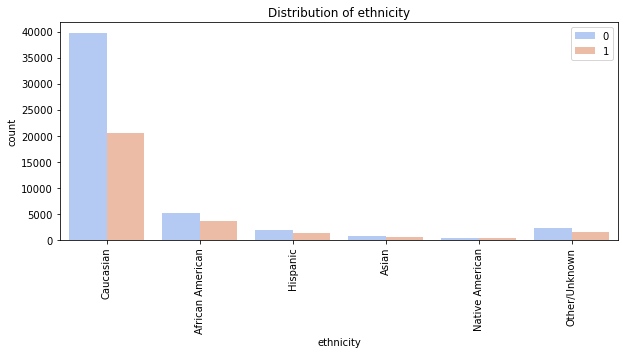

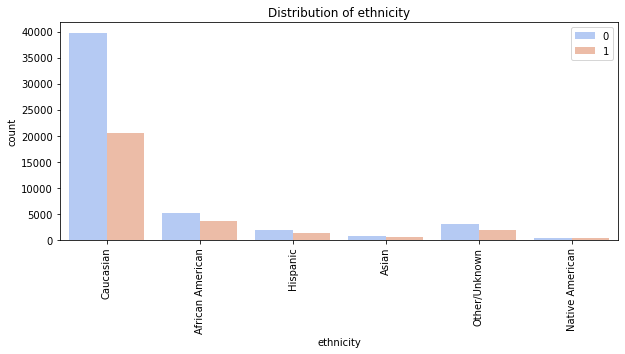

In [13]:
# Observations with missing ethnicity will be imputed with "Other/Unknown"
# Stats Before dropping
sum_stats(diabetes_df, 'ethnicity', 'Before')

# Dropping
diabetes_df.ethnicity.fillna('Other/Unknown', inplace = True)

# Stats After dropping
sum_stats(diabetes_df, 'ethnicity', 'After')


Before dropping: (79144, 49)
Found gender = NaN in 18 observations
Before dropping: 
count     79126
unique        2
top           M
freq      42911
Name: gender, dtype: object

After dropping: (79126, 49)
Found gender = NaN in 0 observations
After dropping: 
count     79126
unique        2
top           M
freq      42911
Name: gender, dtype: object


0        False
1        False
2        False
3        False
4        False
         ...  
79154    False
79155    False
79156    False
79157    False
79158    False
Name: gender, Length: 79126, dtype: bool

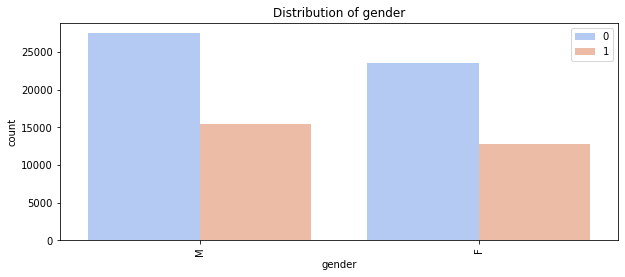

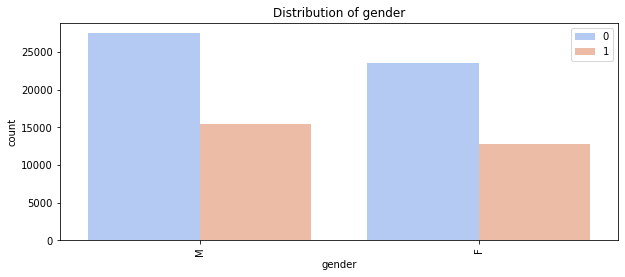

In [14]:
# Observations with missing gender will be discarded

# Stats Before dropping
filter = sum_stats(diabetes_df, 'gender', 'Before')

# Dropping
diabetes_df = diabetes_df[~filter]

# Stats After dropping
sum_stats(diabetes_df, 'gender', 'After')


Before dropping: (79126, 49)
Found height = NaN in 1169 observations
Before dropping: 
count    77957.000000
mean       169.565158
std         10.835014
min        137.200000
25%        162.500000
50%        170.000000
75%        177.800000
max        195.590000
Name: height, dtype: float64

After dropping: (77957, 49)
Found height = NaN in 0 observations
After dropping: 
count    77957.000000
mean       169.565158
std         10.835014
min        137.200000
25%        162.500000
50%        170.000000
75%        177.800000
max        195.590000
Name: height, dtype: float64


0        False
1        False
2        False
3        False
4        False
         ...  
79154    False
79155    False
79156    False
79157    False
79158    False
Name: height, Length: 77957, dtype: bool

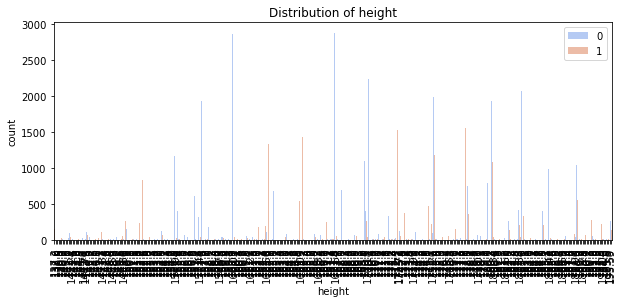

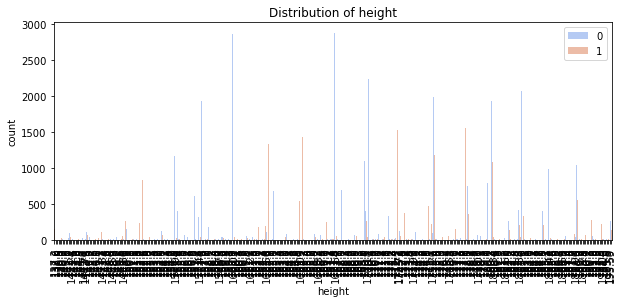

In [14]:
# Observations with missing height will be discarded
# Stats Before dropping
filter = sum_stats(diabetes_df, 'height', 'Before')

# Dropping
diabetes_df = diabetes_df[~filter]

# Stats After dropping
sum_stats(diabetes_df, 'height', 'After')


Before dropping: (77957, 49)
Found weight = NaN in 1510 observations
Before dropping: 
count    76447.000000
mean        85.120671
std         25.466869
min         38.600000
25%         67.700000
50%         81.600000
75%         98.400000
max        186.000000
Name: weight, dtype: float64

After dropping: (76447, 49)
Found weight = NaN in 0 observations
After dropping: 
count    76447.000000
mean        85.120671
std         25.466869
min         38.600000
25%         67.700000
50%         81.600000
75%         98.400000
max        186.000000
Name: weight, dtype: float64


0        False
1        False
2        False
4        False
5        False
         ...  
79154    False
79155    False
79156    False
79157    False
79158    False
Name: weight, Length: 76447, dtype: bool

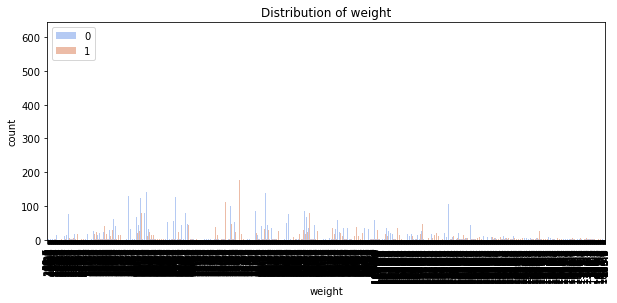

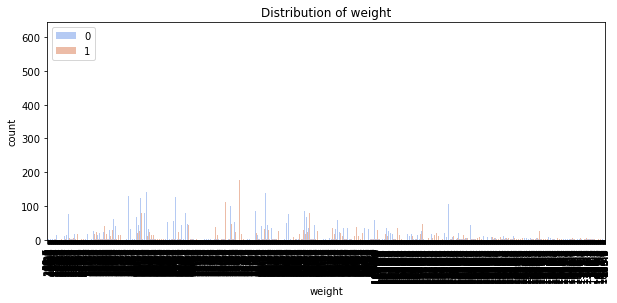

In [15]:
# Observations with missing weight will be discarded
# Stats Before dropping
filter = sum_stats(diabetes_df, 'weight', 'Before')

# Dropping
diabetes_df = diabetes_df[~filter]

# Stats After dropping
sum_stats(diabetes_df, 'weight', 'After')

In [16]:
# BMI can be imputed using height and weight (but no obs missing after dropping height and weight)
missing_obs = len(diabetes_df[(diabetes_df.bmi.isna())])

print(f'Found bmi = NaN in {missing_obs} observations')
count_missing_values(diabetes_df)

Found bmi = NaN in 0 observations

Missing values: 440799 (11.77%)


In [17]:
# Describe shape after dropping
print(diabetes_df.shape)
count_missing_values(diabetes_df)

# Reset index of the new dataframe
diabetes_df = diabetes_df.reset_index(drop=True)
diabetes_df

(76447, 49)

Missing values: 440799 (11.77%)


,encounter_id,hospital_id,gender,ethnicity,age,elective_surgery,height,weight,bmi,icu_type,...,map_apache,aids,cirrhosis,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,ventilated_apache,diabetes_mellitus
0,214826,118,M,Caucasian,68.0,0,180.3,73.9,22.732803,CTICU,...,40.0,0,0,0,0,0,0,0,0,1
1,276985,118,F,Caucasian,25.0,0,172.7,95.3,31.952749,Med-Surg ICU,...,68.0,0,0,0,0,0,0,0,0,0
2,262220,118,F,Caucasian,81.0,1,165.1,61.7,22.635548,CTICU,...,60.0,0,0,0,0,0,0,0,1,0
3,246060,81,F,Caucasian,77.0,0,160.0,70.2,27.421875,Med-Surg ICU,...,46.0,0,0,0,0,0,0,0,1,1
4,182697,83,M,Caucasian,67.0,0,190.5,100.0,27.555611,Med-Surg ICU,...,130.0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76442,166024,146,F,Caucasian,86.0,0,167.6,86.2,30.687339,Med-Surg ICU,...,137.0,0,0,0,0,0,0,0,0,0
76443,185015,154,F,Caucasian,55.0,0,165.1,91.7,33.641487,MICU,...,59.0,0,0,0,1,0,0,1,0,0
76444,173688,47,M,African American,61.0,0,173.0,88.1,29.436333,CTICU,...,173.0,0,0,0,0,0,0,0,0,0
76445,169835,120,M,Caucasian,80.0,0,175.0,84.8,27.689796,CCU-CTICU,...,54.0,0,0,0,1,0,0,0,0,0


## 2.1.2 Find dulplicates and highly correlated information

## Find duplicated columns and drop

In [18]:
# Find duplicated columns and drop
identical_column = 0
for column_1 in columns:
    for column_2 in columns:
        if (diabetes_df[column_1].equals(diabetes_df[column_2])) and (column_1 != column_2):
            print(f'{column_1} and {column_2} are identical')
            identical_column += 1
            
print(f'There are a total of {identical_column} identical columns')

There are a total of 0 identical columns


## Find highly correlated columns and drop

gcs_motor_apache   gcs_eyes_apache      0.798603
gcs_eyes_apache    gcs_motor_apache     0.798603
d1_heartrate_max   heart_rate_apache    0.809672
heart_rate_apache  d1_heartrate_max     0.809672
d1_hco3_min        d1_hco3_max          0.813128
d1_hco3_max        d1_hco3_min          0.813128
d1_sodium_max      d1_sodium_min        0.821146
d1_sodium_min      d1_sodium_max        0.821146
h1_temp_max        h1_temp_min          0.862912
h1_temp_min        h1_temp_max          0.862912
weight             bmi                  0.880320
bmi                weight               0.880320
d1_albumin_max     d1_albumin_min       0.911667
d1_albumin_min     d1_albumin_max       0.911667
d1_wbc_max         d1_wbc_min           0.915130
d1_wbc_min         d1_wbc_max           0.915130
                   wbc_apache           0.925318
wbc_apache         d1_wbc_min           0.925318
d1_platelets_min   d1_platelets_max     0.960561
d1_platelets_max   d1_platelets_min     0.960561
d1_bun_min         d

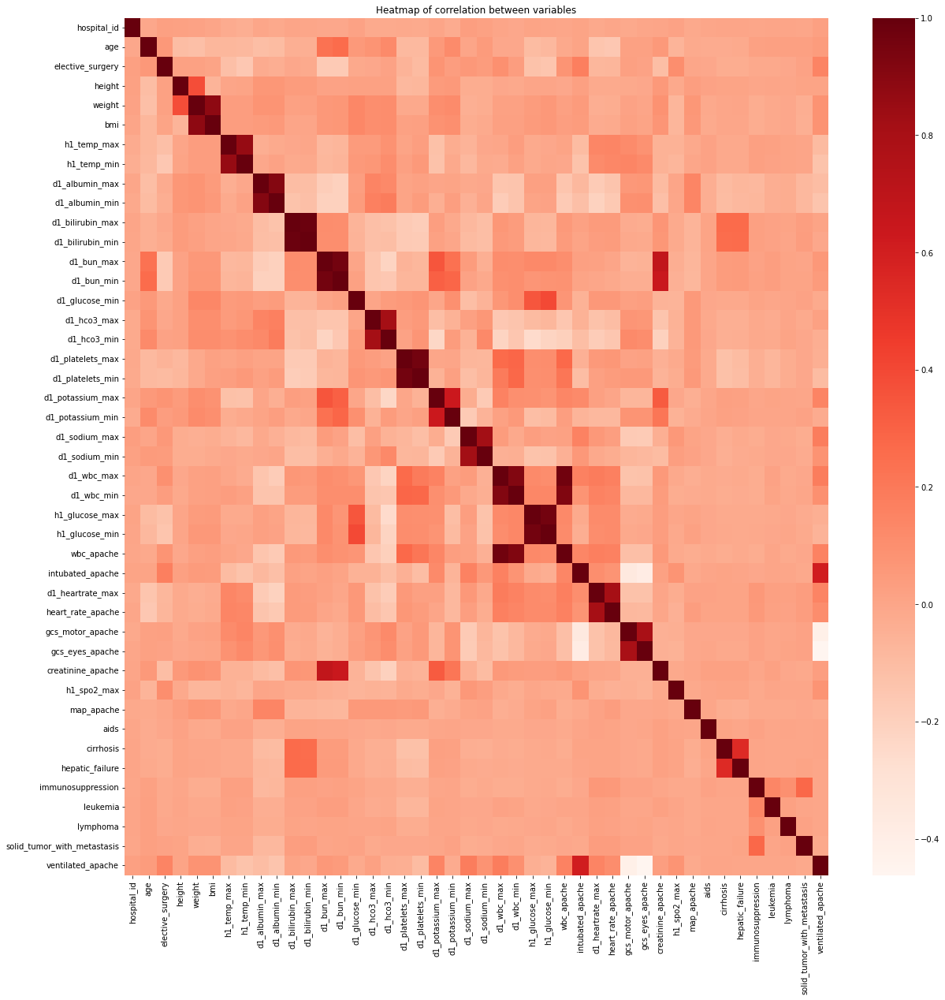

In [19]:
def correlation_analysis(df):
    """Function for correlation analysis"""
    # Initialize correlation metrix
    corr = df.loc[:,~df.columns.isin(['diabetes_mellitus','encounter_id'])].corr()
    # Plot a heatmap for correlation matrix
    plt.figure(figsize=(20,20))
    sns.heatmap(data=corr, annot=False, cmap=plt.cm.Reds)
    plt.title('Heatmap of correlation between variables')
    # Sorting correlation matrix
    c = corr.abs()
    s = c.unstack()
    sorted_corr = s.sort_values(kind="quicksort")
    # Find columns which are > 70% correlated
    print(sorted_corr[(sorted_corr>=0.7) & (sorted_corr<1.0)].to_string())
    
correlation_analysis(diabetes_df)

In [20]:
def KDEPlots(df1,df2,row_num,column_num,label1,label2,columns):
    """ Make KDE plots by superimposing KDE plots for df1 and df2"""
    plt.figure(figsize=(30,25))
    i=1
    for column in columns:
        plt.subplot(row_num,column_num,i)
        # Plot each individual target income
        sns.kdeplot(data=df1[column], label=label1, shade=True)
        sns.kdeplot(data=df2[column], label=label2, shade=True)
        # Add title
        plt.title(f"Distribution of {column}")
        # Add legend
        plt.legend()
        i+=1

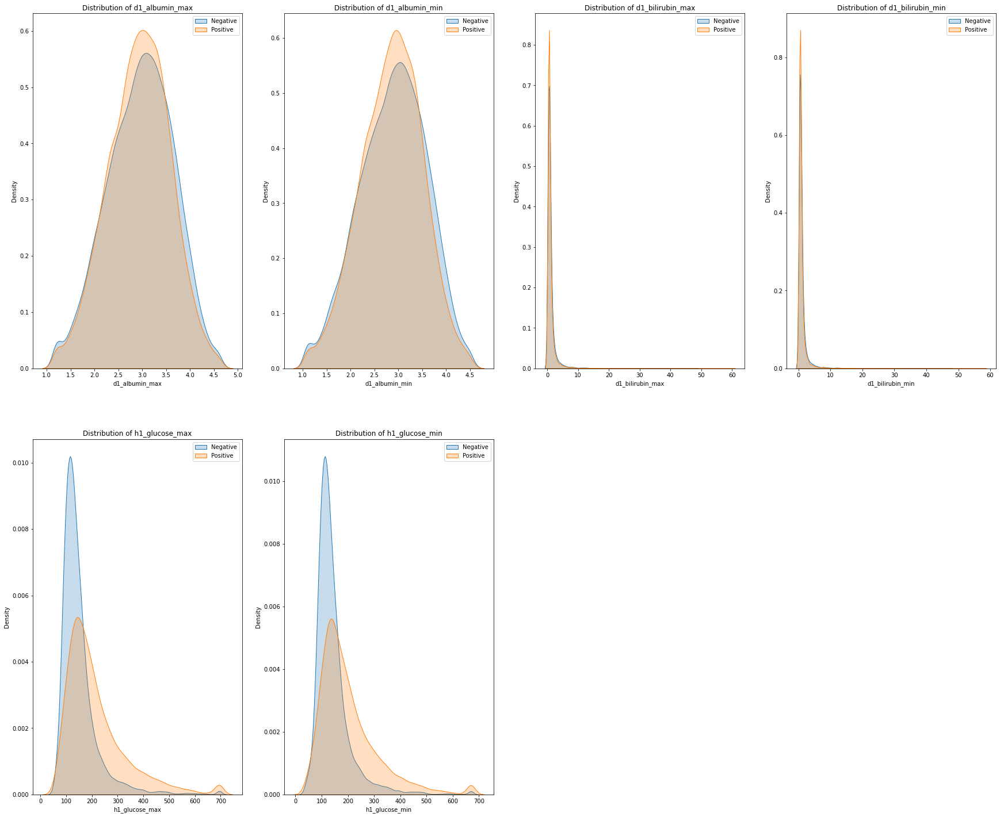

In [21]:
# Separate orginal data frame using target variable
diabetes_df_0 = diabetes_df.loc[(diabetes_df['diabetes_mellitus']==0)]
diabetes_df_1 = diabetes_df.loc[(diabetes_df['diabetes_mellitus']==1)]

missing_columns = ["d1_albumin_max","d1_albumin_min","d1_bilirubin_max","d1_bilirubin_min",
                   "h1_glucose_max","h1_glucose_min"]

KDEPlots(diabetes_df_0, diabetes_df_1,2,4,'Negative','Positive', missing_columns)

## gcs_motor_apache, gcs_eyes_apache

## GCS Score: https://en.wikipedia.org/wiki/Glasgow_Coma_Scale

In [22]:
# GCS Score is the sum of score of each test (E for Eye, V for Verbal, and M for Motor)
gcs_columns = ['gcs_eyes_apache', 'gcs_motor_apache']

diabetes_df['gcs_score'] = diabetes_df[gcs_columns].sum(axis=1)

# numerical_columns.append('gcs_score')
diabetes_df.drop(gcs_columns, axis=1, inplace=True)

columns.append('gcs_score')

for column in gcs_columns:
    columns.remove(column)

print(len(columns))

48


## Weight and BMI => drop weight

In [23]:
# Drop weight
diabetes_df.drop('weight', axis=1, inplace=True)

columns.remove('weight')

print(len(columns))

47


## Lab_based variables: ._apache, d1_..._min/max, h1_..._min/max

## 1.
## heart_rate_apache and d1_heartrate_max 
## wbc_apache and d1_wbc_max

In [24]:
# Drop heart_rate_apache
diabetes_df.drop('heart_rate_apache', axis=1, inplace=True)

columns.remove('heart_rate_apache')

# Drop wbc_apache
diabetes_df.drop('wbc_apache', axis=1, inplace=True)

columns.remove('wbc_apache')

print(len(columns))

45


## 2. min/max

##  Mean labotory numerical data (because we have min/max)

In [25]:
# Specify min max columns => only keep the mean
min_max_columns = [
    'h1_temp_max', 
    'h1_temp_min', 
    'd1_albumin_max', 
    'd1_albumin_min',
    'd1_bilirubin_max', 
    'd1_bilirubin_min',
    'd1_bun_max', 
    'd1_bun_min', 
    'd1_hco3_max', 
    'd1_hco3_min', 
    'd1_platelets_max', 
    'd1_platelets_min', 
    'd1_potassium_max', 
    'd1_potassium_min', 
    'd1_sodium_max', 
    'd1_sodium_min', 
    'd1_wbc_max', 
    'd1_wbc_min', 
    'h1_glucose_max', 
    'h1_glucose_min',
]

## Min-Max column outliers

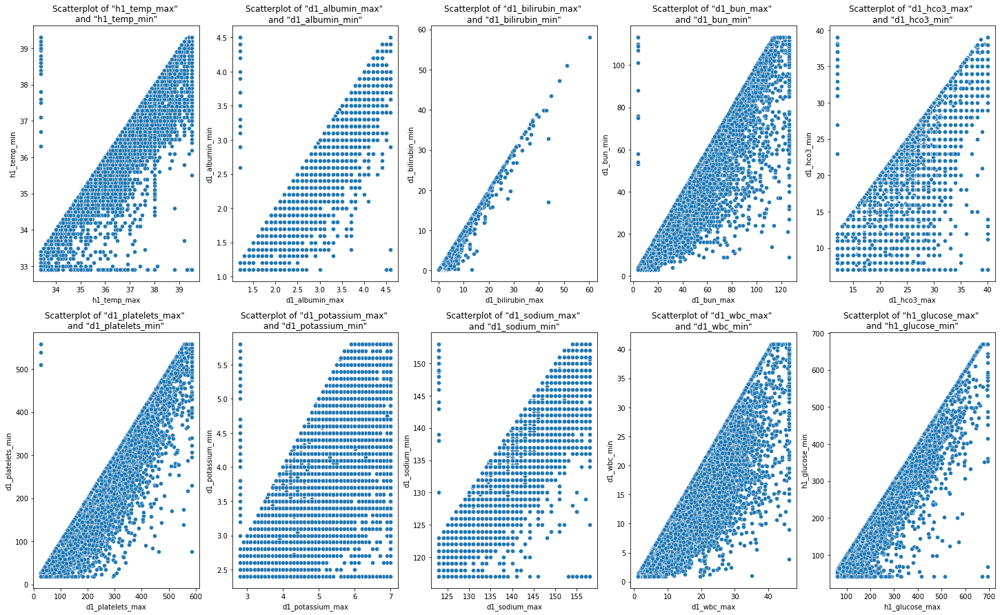

In [26]:
def SCATPlots_min_max(df, rows, cols):
    """ Make scatterplots for min and max"""
     # Add figure box
    plt.figure(figsize=(25,15))
    i=0
    u=1
    for column in min_max_columns:
        while i <= 20 and 'max' in column:
            plt.subplot(rows,cols,u)
            max_column = min_max_columns[i]
            min_column = min_max_columns[i+1]
            sns.scatterplot(x = df[max_column], y=df[min_column])
            plt.title(f'Scatterplot of "{max_column}" \nand "{min_column}"')
            i+=2
            u+=1
            
SCATPlots_min_max(diabetes_df,2,5)

In [27]:
# Swap min and max values in all columns if min > max
def swap_min_max(df):
    """Function to swap min/max values if min>max"""
    i=0
    for column in min_max_columns:
        if i <= 20 and 'max' in column:
            max_min_columns_used = [min_max_columns[i],min_max_columns[i+1]]
            max_column = min_max_columns[i]
            min_column = min_max_columns[i+1]
            df[min_column], df[max_column] = np.where((df[min_column] > df[max_column]), 
                                                                [df[max_column], df[min_column]], 
                                                                [df[min_column], df[max_column]])
            i+=2
            
swap_min_max(diabetes_df)

In [28]:
# Construct variable_mean variables
i = 0
for column in min_max_columns:
    if i <= 20 and 'max' in column:
        max_min_columns_used = [min_max_columns[i],min_max_columns[i+1]]
        diabetes_df[f"{column.rstrip('_max')}_mean"] = diabetes_df[max_min_columns_used].mean(axis=1)
        diabetes_df.drop(max_min_columns_used[0],axis=1,inplace=True)
        diabetes_df.drop(max_min_columns_used[1],axis=1,inplace=True)
        columns.remove(max_min_columns_used[0])
        columns.remove(max_min_columns_used[1])
        columns.append(f"{column.rstrip('_max')}_mean")
        i+=2

In [29]:
mean_columns=[
    'h1_temp_mean',
    'd1_albumin_mean',
    'd1_bilirubin_mean',
    'd1_bun_mean',
    'd1_hco3_mean',
    'd1_platelets_mean',
    'd1_potassiu_mean',
    'd1_sodiu_mean',
    'd1_wbc_mean',
    'h1_glucose_mean'
]

Series([], )


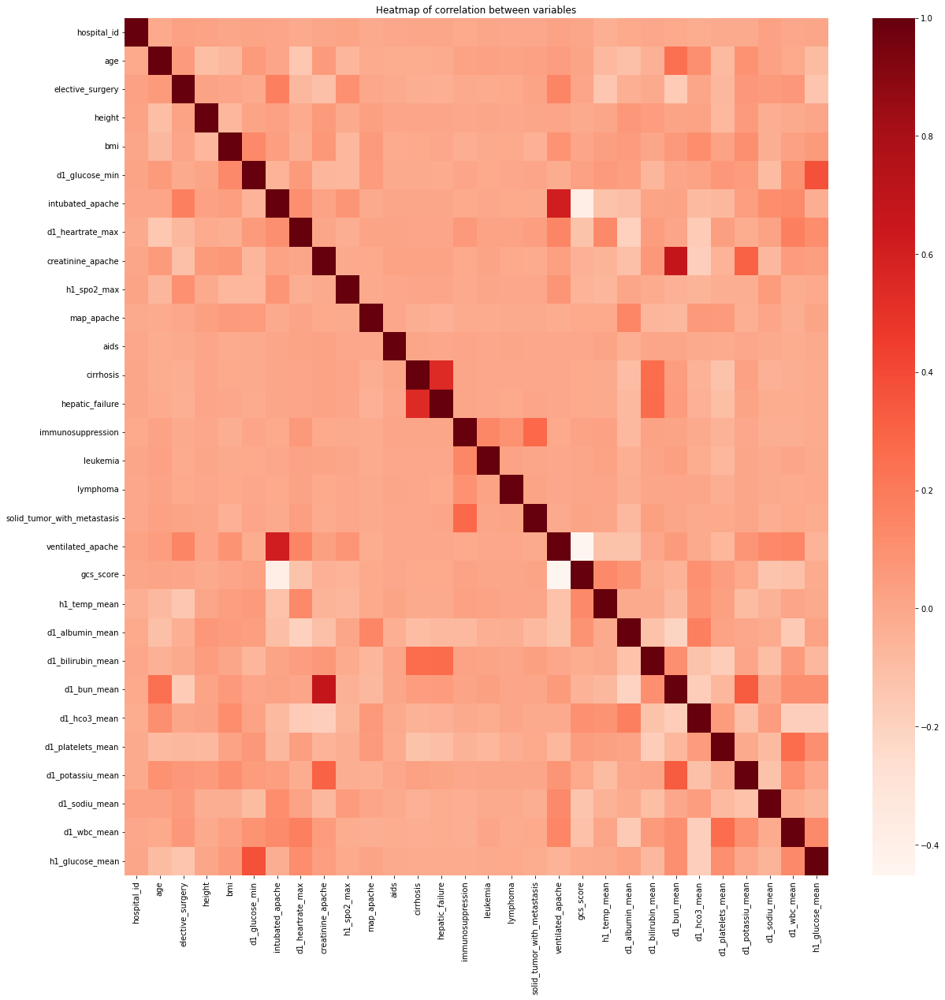

In [30]:
correlation_analysis(diabetes_df)

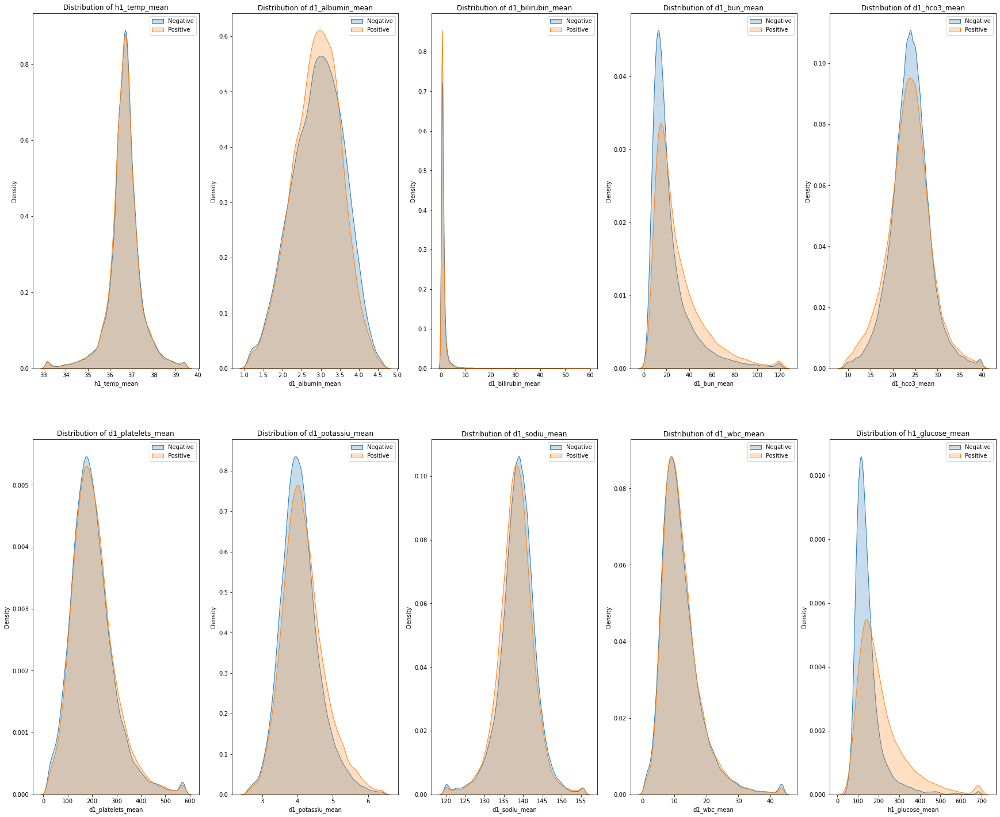

In [31]:
# Separate orginal data frame using target variable
diabetes_df_0 = diabetes_df.loc[(diabetes_df['diabetes_mellitus']==0)]
diabetes_df_1 = diabetes_df.loc[(diabetes_df['diabetes_mellitus']==1)]

KDEPlots(diabetes_df_0, diabetes_df_1,2,5,'Negative','Positive', mean_columns)

## Modelling missingness of lab-based data

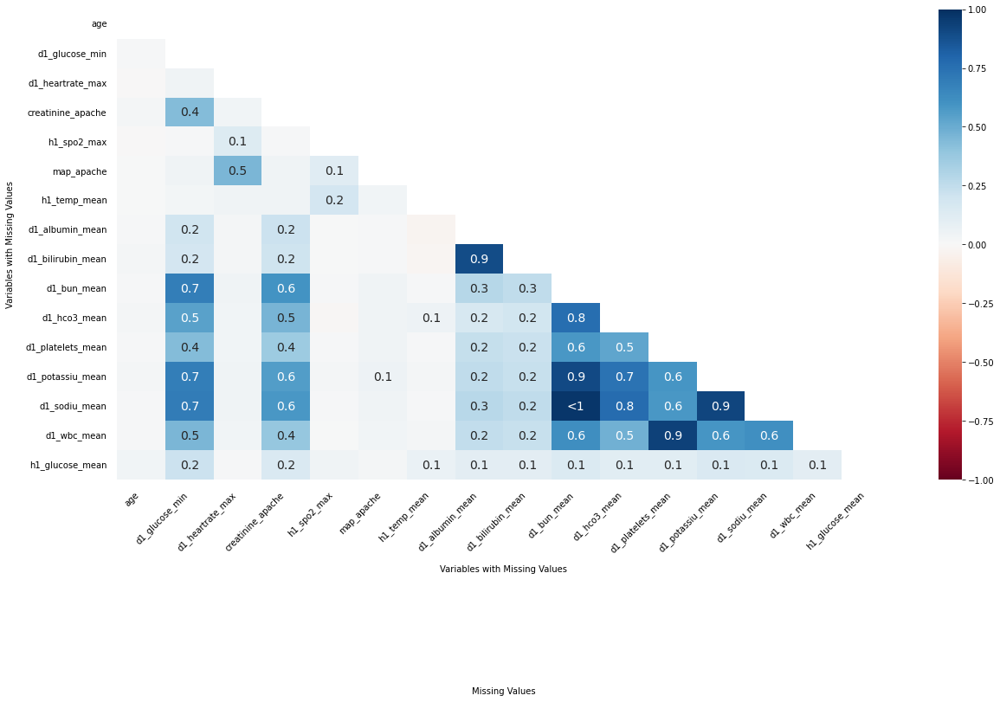

In [32]:
import missingno as msno
# Visualize the number of missing values as a heatmap
fig = msno.heatmap(diabetes_df, inline=False, figsize=(20,10))

# Add labels
plt.xlabel('Variables with Missing Values', size=10, labelpad=12)
plt.ylabel('Variables with Missing Values', size=10, labelpad=12)
plt.tick_params(axis='both', labelsize=10, length=8)

plt.text(0.5, -0.45, s='Missing Values', fontsize=10, ha='center', va='center', transform=fig.transAxes)

plt.show;

36.15
25.08


<AxesSubplot:>

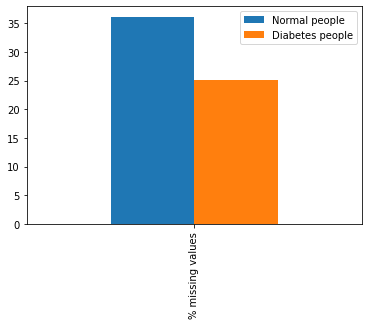

In [33]:
# Df of normal people with missing data
mask = (diabetes_df['d1_albumin_mean'].isnull()) & (diabetes_df['d1_bilirubin_mean'].isnull()) & (diabetes_df['h1_glucose_mean'].isnull()) & (diabetes_df['diabetes_mellitus'] == 0)
df_normal_full = diabetes_df[diabetes_df['diabetes_mellitus'] == 0]
df_normal_mask = diabetes_df[mask]
missing_percent_1 = df_normal_mask.shape[0]/df_normal_full.shape[0]*100
print(round(missing_percent_1,2))

# Df of sick people with missing data
mask = (diabetes_df['d1_albumin_mean'].isnull()) & (diabetes_df['d1_bilirubin_mean'].isnull()) & (diabetes_df['h1_glucose_mean'].isnull()) & (diabetes_df['diabetes_mellitus'] == 1)
df_sick_full = diabetes_df[diabetes_df['diabetes_mellitus'] == 1]
df_sick_mask = diabetes_df[mask]
missing_percent_2 = df_sick_mask.shape[0]/df_sick_full.shape[0]*100
print(round(missing_percent_2,2))

# Plot to see % missing between normal and diabetes people
df = pd.DataFrame({'Normal people':[missing_percent_1], 'Diabetes people':[missing_percent_2]},index=['% missing values'])

df.plot(kind='bar')

## Missing values indicators (1/0) (https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6329436/)

In [34]:
# Separate numerical and categorical columns

categorical_columns = ['hospital_id','gender','ethnicity','icu_type','elective_surgery','aids','cirrhosis','hepatic_failure',
                       'immunosuppression','leukemia','lymphoma','solid_tumor_with_metastasis','ventilated_apache',
                       'intubated_apache']

    numerical_columns = []
    for column in columns:
        if column not in categorical_columns and column not in ['encounter_id','diabetes_mellitus']:
            numerical_columns.append(column)

    numerical_columns

['age',
 'height',
 'bmi',
 'd1_glucose_min',
 'd1_heartrate_max',
 'creatinine_apache',
 'h1_spo2_max',
 'map_apache',
 'gcs_score',
 'h1_temp_mean',
 'd1_albumin_mean',
 'd1_bilirubin_mean',
 'd1_bun_mean',
 'd1_hco3_mean',
 'd1_platelets_mean',
 'd1_potassiu_mean',
 'd1_sodiu_mean',
 'd1_wbc_mean',
 'h1_glucose_mean']

In [35]:
# Check existing columns that have missing values

for column in numerical_columns:
    total_cells = diabetes_df.shape[0]
    # Find missing data in each columns
    missing_values_count = diabetes_df[column].isnull().sum()
    # Calculate percent of missing data and print
    percent_missing_data = round((missing_values_count/total_cells)*100,2)
    if percent_missing_data > 0:
        print(f'{column}: {percent_missing_data}% missing data')

age: 3.57% missing data
d1_glucose_min: 5.31% missing data
d1_heartrate_max: 0.13% missing data
creatinine_apache: 18.12% missing data
h1_spo2_max: 4.68% missing data
map_apache: 0.22% missing data
h1_temp_mean: 22.41% missing data
d1_albumin_mean: 54.18% missing data
d1_bilirubin_mean: 58.52% missing data
d1_bun_mean: 9.68% missing data
d1_hco3_mean: 14.82% missing data
d1_platelets_mean: 13.85% missing data
d1_potassiu_mean: 8.84% missing data
d1_sodiu_mean: 9.31% missing data
d1_wbc_mean: 12.99% missing data
h1_glucose_mean: 55.04% missing data


In [36]:
missing_columns = {
    'creatinine_apache': 'i_creatinine',
    'h1_temp_mean': 'i_temp',
    'd1_albumin_mean': 'i_albumin',
    'd1_bilirubin_mean': 'i_bilirubin',
    'h1_glucose_mean': 'i_glucose',
}

for column,name in missing_columns.items():
    append_column = diabetes_df[column]
    append_column = append_column.isnull().astype('int')
    diabetes_df[name] = append_column

In [37]:
diabetes_df

,encounter_id,hospital_id,gender,ethnicity,age,elective_surgery,height,bmi,icu_type,d1_glucose_min,...,d1_platelets_mean,d1_potassiu_mean,d1_sodiu_mean,d1_wbc_mean,h1_glucose_mean,i_creatinine,i_temp,i_albumin,i_bilirubin,i_glucose
0,214826,118,M,Caucasian,68.0,0,180.3,22.732803,CTICU,109.0,...,233.0,3.70,135.0,14.1,NaN,0,0,0,0,1
1,276985,118,F,Caucasian,25.0,0,172.7,31.952749,Med-Surg ICU,NaN,...,NaN,NaN,NaN,NaN,NaN,1,0,1,1,1
2,262220,118,F,Caucasian,81.0,1,165.1,22.635548,CTICU,88.0,...,120.5,4.25,NaN,8.5,NaN,1,0,1,1,1
3,246060,81,F,Caucasian,77.0,0,160.0,27.421875,Med-Surg ICU,128.0,...,522.0,4.00,145.0,18.0,144.0,0,0,0,0,0
4,182697,83,M,Caucasian,67.0,0,190.5,27.555611,Med-Surg ICU,125.0,...,159.0,3.80,137.0,10.9,NaN,0,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76442,166024,146,F,Caucasian,86.0,0,167.6,30.687339,Med-Surg ICU,117.0,...,186.0,3.90,140.0,9.6,NaN,0,0,1,1,1
76443,185015,154,F,Caucasian,55.0,0,165.1,33.641487,MICU,136.0,...,146.0,3.70,132.0,18.6,NaN,0,0,1,1,1
76444,173688,47,M,African American,61.0,0,173.0,29.436333,CTICU,103.0,...,174.0,NaN,NaN,9.0,598.0,1,0,0,0,0
76445,169835,120,M,Caucasian,80.0,0,175.0,27.689796,CCU-CTICU,127.0,...,249.0,4.80,143.0,12.0,NaN,0,1,0,0,1


## Before running imputing -> encode all categorical data into numerical


## Categorical variables encoding

In [38]:
# Encode gender
from sklearn.preprocessing import LabelEncoder

# Encode the labels from strings to values.
le = LabelEncoder()

# Fit transform target variable
diabetes_df['gender'] = le.fit_transform(diabetes_df['gender'])

print(le.classes_)
diabetes_df['gender']

['F' 'M']


0        1
1        0
2        0
3        0
4        1
        ..
76442    0
76443    0
76444    1
76445    1
76446    1
Name: gender, Length: 76447, dtype: int32

In [39]:
# For Ethnicity, icu_type -> OneHotEncoder
from sklearn.preprocessing import OneHotEncoder

# Creating instance of one-hot-encoder
enc = OneHotEncoder(handle_unknown='ignore')

# Loop through categorical columns
for column in categorical_columns[2:4]:
    # Passing column
    enc_df = pd.DataFrame(enc.fit_transform(diabetes_df[[f'{column}']]).toarray())
    enc_df.columns = enc.get_feature_names([f'{column[0]}'])
    print(enc_df.iloc[:,0:len(enc_df.columns)-1])
    # Concatenate with previous data (excluding the last column: NaN)
    diabetes_df = pd.concat([diabetes_df, enc_df.iloc[:,0:len(enc_df.columns)-1]], axis=1)
    print(diabetes_df)
    
# Add new columns to columns list
columns = list(diabetes_df.columns)

# Remove original columns from the data frame
diabetes_df.drop('ethnicity', axis=1, inplace=True)
diabetes_df.drop('icu_type', axis=1, inplace=True)
columns.remove('ethnicity')
columns.remove('icu_type')

print(diabetes_df)
print(columns)

       e_African American  e_Asian  e_Caucasian  e_Hispanic  e_Native American
0                     0.0      0.0          1.0         0.0                0.0
1                     0.0      0.0          1.0         0.0                0.0
2                     0.0      0.0          1.0         0.0                0.0
3                     0.0      0.0          1.0         0.0                0.0
4                     0.0      0.0          1.0         0.0                0.0
...                   ...      ...          ...         ...                ...
76442                 0.0      0.0          1.0         0.0                0.0
76443                 0.0      0.0          1.0         0.0                0.0
76444                 1.0      0.0          0.0         0.0                0.0
76445                 0.0      0.0          1.0         0.0                0.0
76446                 0.0      0.0          1.0         0.0                0.0

[76447 rows x 5 columns]
       encounter_id  hospi

## Impute numerical missing data using multiple imputation (MI)

In [40]:
# Separate numerical and categorical columns

categorical_columns = ['hospital_id','gender','elective_surgery','aids','cirrhosis','hepatic_failure',
                       'immunosuppression','leukemia','lymphoma','solid_tumor_with_metastasis','ventilated_apache',
                       'intubated_apache', 'i_creatinine','i_temp','i_albumin','i_bilirubin','i_glucose', 'e_African American',
                       'e_Asian','e_Caucasian','e_Hispanic','e_Native American', 'i_CCU-CTICU', 'i_CSICU','i_CTICU',
                       'i_Cardiac ICU','i_MICU','i_Med-Surg ICU','i_Neuro ICU']

numerical_columns = []
for column in columns:
    if column not in categorical_columns and column not in ['encounter_id','diabetes_mellitus']:
        numerical_columns.append(column)
        
numerical_columns

['age',
 'height',
 'bmi',
 'd1_glucose_min',
 'd1_heartrate_max',
 'creatinine_apache',
 'h1_spo2_max',
 'map_apache',
 'gcs_score',
 'h1_temp_mean',
 'd1_albumin_mean',
 'd1_bilirubin_mean',
 'd1_bun_mean',
 'd1_hco3_mean',
 'd1_platelets_mean',
 'd1_potassiu_mean',
 'd1_sodiu_mean',
 'd1_wbc_mean',
 'h1_glucose_mean']

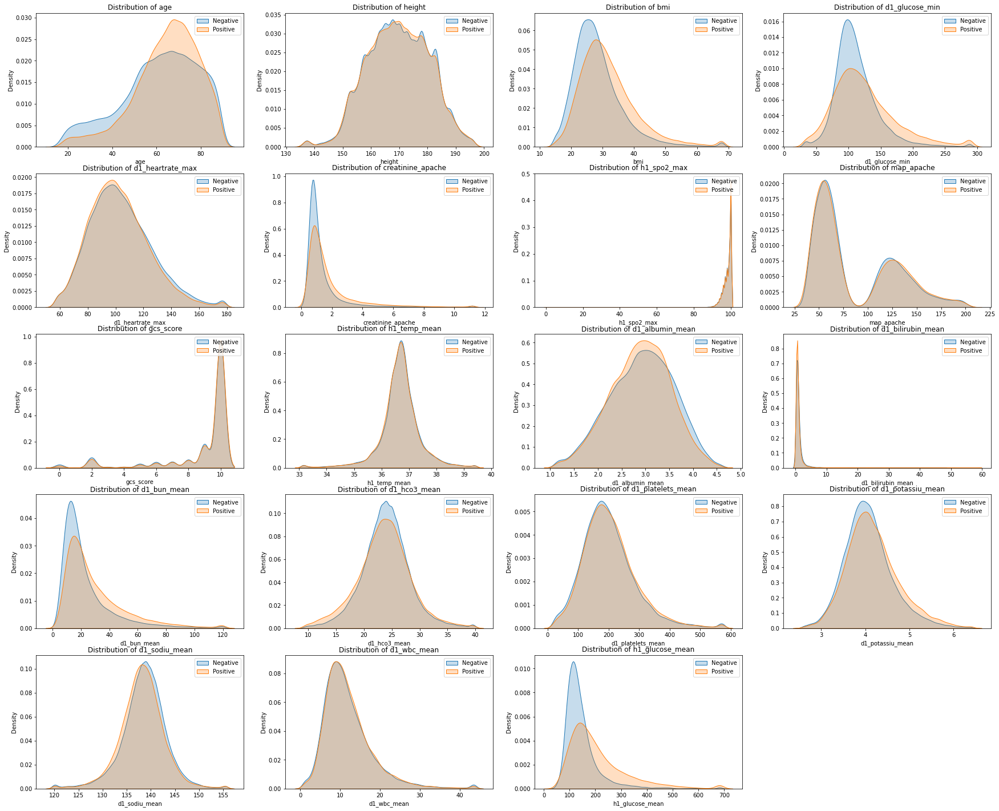

In [41]:
# Separate orginal data frame using target variable
diabetes_df_0 = diabetes_df.loc[(diabetes_df['diabetes_mellitus']==0)]
diabetes_df_1 = diabetes_df.loc[(diabetes_df['diabetes_mellitus']==1)]

KDEPlots(diabetes_df_0, diabetes_df_1,5,4,'Negative','Positive', numerical_columns)

In [42]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

mice_imputer = IterativeImputer(random_state=1) # default max_iter=10 for rounds of imputation
diabetes_df_copy_2 = mice_imputer.fit_transform(diabetes_df)
diabetes_df_copy_2 = pd.DataFrame(diabetes_df_copy_2, columns=diabetes_df.columns)

count_missing_values(diabetes_df_copy_2)
print(diabetes_df_copy_2.shape)
diabetes_df_copy_2


Missing values: 0 (0.0%)
(76447, 50)


,encounter_id,hospital_id,gender,age,elective_surgery,height,bmi,d1_glucose_min,intubated_apache,d1_heartrate_max,...,e_Caucasian,e_Hispanic,e_Native American,i_CCU-CTICU,i_CSICU,i_CTICU,i_Cardiac ICU,i_MICU,i_Med-Surg ICU,i_Neuro ICU
0,214826.0,118.0,1.0,68.0,0.0,180.3,22.732803,109.000000,0.0,119.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,276985.0,118.0,0.0,25.0,0.0,172.7,31.952749,115.554593,0.0,96.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,262220.0,118.0,0.0,81.0,1.0,165.1,22.635548,88.000000,1.0,116.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,246060.0,81.0,0.0,77.0,0.0,160.0,27.421875,128.000000,0.0,118.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,182697.0,83.0,1.0,67.0,0.0,190.5,27.555611,125.000000,0.0,113.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76442,166024.0,146.0,0.0,86.0,0.0,167.6,30.687339,117.000000,0.0,116.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
76443,185015.0,154.0,0.0,55.0,0.0,165.1,33.641487,136.000000,0.0,114.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
76444,173688.0,47.0,1.0,61.0,0.0,173.0,29.436333,103.000000,0.0,104.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
76445,169835.0,120.0,1.0,80.0,0.0,175.0,27.689796,127.000000,0.0,125.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


i_bilirubin  i_albumin      0.897228
i_albumin    i_bilirubin    0.897228


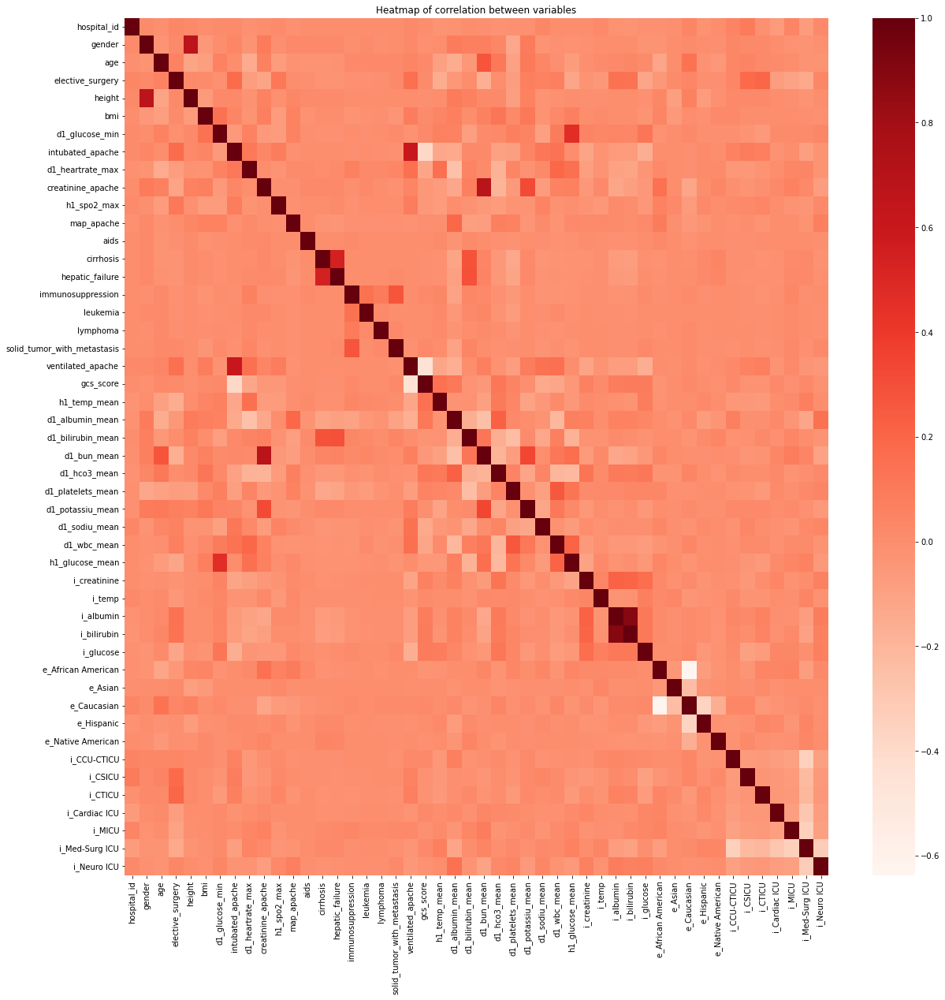

In [43]:
correlation_analysis(diabetes_df_copy_2)

In [46]:
# # Import the relevant methods
# from sklearn.impute import KNNImputer
# np.random.seed(1)

# # Store new data frame to impute
# impute_df = diabetes_df[columns]

# # Apply KNN imputer
# imputer = KNNImputer(n_neighbors=3, weights="distance")
# imputed_df = imputer.fit_transform(impute_df)

In [47]:
# # Specify null columns
# null_columns = list(diabetes_df.columns[diabetes_df.isnull().any()])

# # Missing values before imputing
# print(diabetes_df.isnull().sum().sum())

# # Missing values after imputing
# dataframe = pd.DataFrame.from_records(imputed_df)
# dataframe.columns = columns
# print(dataframe.isnull().sum().sum())

In [44]:
diabetes_df_copy_2.drop('i_albumin',axis=1)

,encounter_id,hospital_id,gender,age,elective_surgery,height,bmi,d1_glucose_min,intubated_apache,d1_heartrate_max,...,e_Caucasian,e_Hispanic,e_Native American,i_CCU-CTICU,i_CSICU,i_CTICU,i_Cardiac ICU,i_MICU,i_Med-Surg ICU,i_Neuro ICU
0,214826.0,118.0,1.0,68.0,0.0,180.3,22.732803,109.000000,0.0,119.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,276985.0,118.0,0.0,25.0,0.0,172.7,31.952749,115.554593,0.0,96.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,262220.0,118.0,0.0,81.0,1.0,165.1,22.635548,88.000000,1.0,116.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,246060.0,81.0,0.0,77.0,0.0,160.0,27.421875,128.000000,0.0,118.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,182697.0,83.0,1.0,67.0,0.0,190.5,27.555611,125.000000,0.0,113.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76442,166024.0,146.0,0.0,86.0,0.0,167.6,30.687339,117.000000,0.0,116.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
76443,185015.0,154.0,0.0,55.0,0.0,165.1,33.641487,136.000000,0.0,114.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
76444,173688.0,47.0,1.0,61.0,0.0,173.0,29.436333,103.000000,0.0,104.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
76445,169835.0,120.0,1.0,80.0,0.0,175.0,27.689796,127.000000,0.0,125.0,...,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


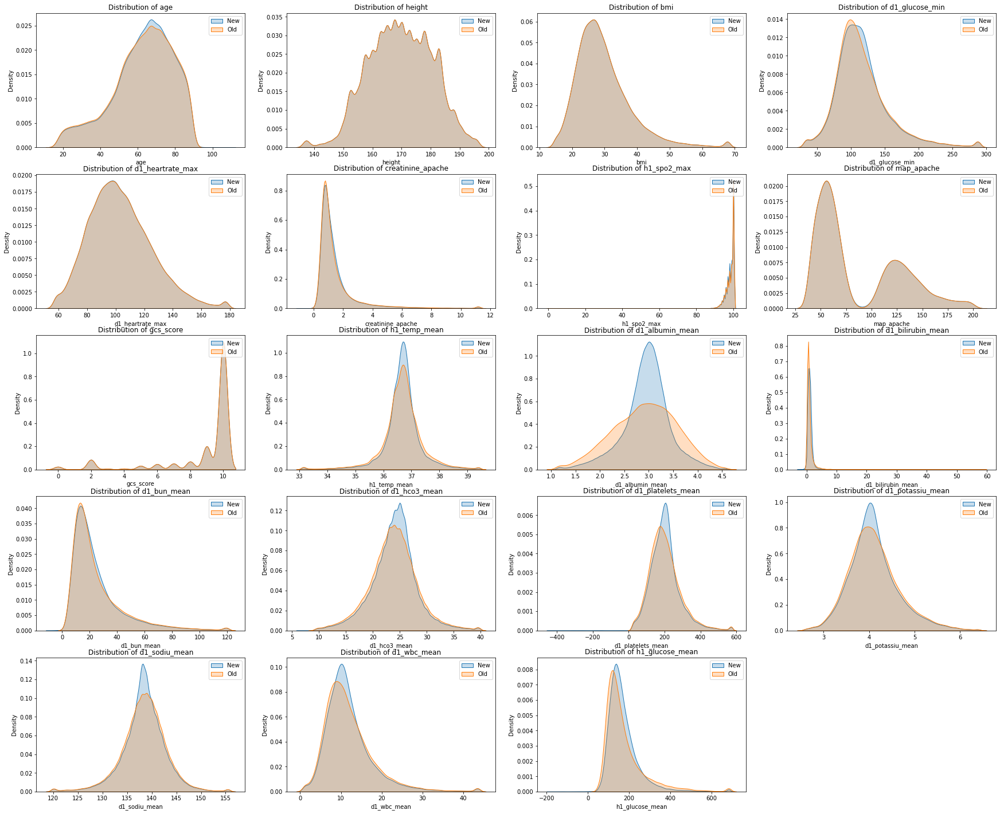

In [45]:
# New and old distribution after imputing

KDEPlots(diabetes_df_copy_2, diabetes_df,5,4,'New','Old', numerical_columns)

## Categorical columns

In [50]:
def CountPlots(df, rows, cols, hue, columns):
    """ Make Count plots by superimposing Count plots for df1 and df2"""
     # Add figure box
    plt.figure(figsize=(30,15))
    i=1
    for column in columns:
        plt.subplot(rows,cols,i)
        # Set labels to be vertical in the axis
        plt.xticks(rotation=90)
        # Produce a plot
        sns.countplot(x=column, hue=hue,palette="coolwarm", data=df)
        # Include a dynamic title
        plt.title("Distribution of " + column)
        # Include a legend
        plt.legend()
        i+=1

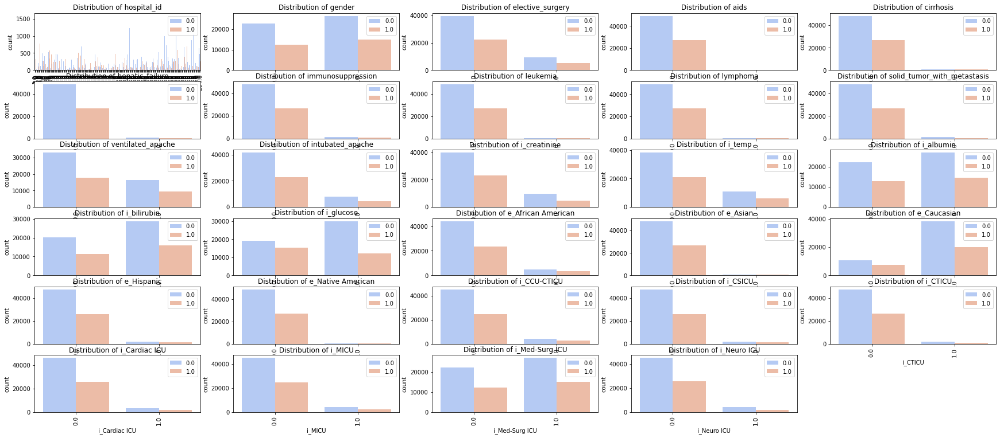

In [54]:
CountPlots(diabetes_df_copy_2,7,5,'diabetes_mellitus',categorical_columns)

=> seems similar, could combine them for feature engineering

## 2.1.2 Outlier dectection

## Boxplots

In [55]:
def BoxPlots(df, rows, cols, columns):
    """ Make box plots"""
     # Add figure box
    plt.figure(figsize=(20,80))
    i=1
    for column in columns:
        plt.subplot(rows,cols,i)
        # Generate Boxplot
        sns.boxplot(y=column, data=df, hue=df['diabetes_mellitus'])
        plt.title(f"Boxplot of gender by income")
        # Add title
        plt.title(f"Boxplot of {column}")
        i+=1

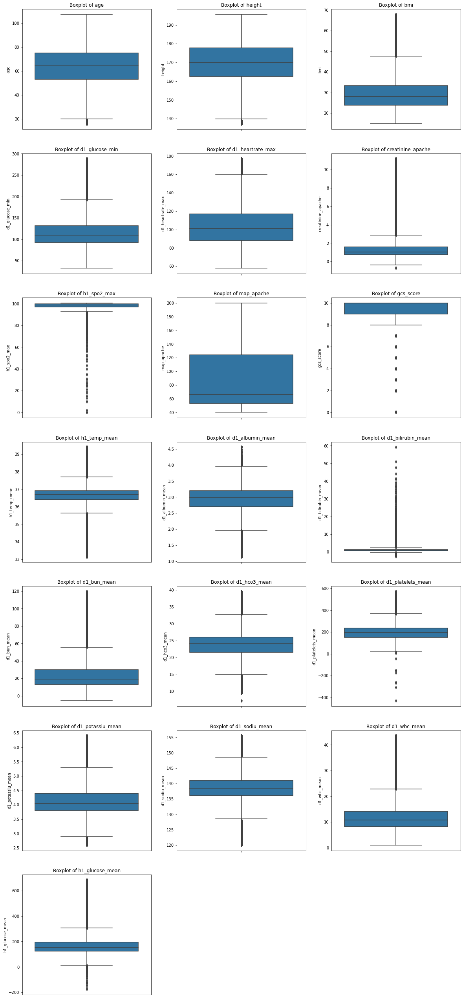

In [56]:
BoxPlots(diabetes_df_copy_2, 12, 3, numerical_columns)

In [46]:
# Find Q1 and Q3 quantile and IQR of the numerical data frame
Q1 = diabetes_df_copy_2[numerical_columns].quantile(0.25)
Q3 = diabetes_df_copy_2[numerical_columns].quantile(0.75)
IQR = Q3 - Q1

In [47]:
# Find % outliers in dataframe
outliers_percent = ((diabetes_df_copy_2[numerical_columns] < (Q1 - 1.5 * IQR)) | (diabetes_df_copy_2[numerical_columns] > (Q3 + 1.5 * IQR))).sum().sum()/np.product(diabetes_df_copy_2[numerical_columns].shape)*100
print(f'Sum of cells: {np.product(diabetes_df_copy_2[numerical_columns].shape)}')
print(f'Sum of outliers: {((diabetes_df_copy_2[numerical_columns] < (Q1 - 1.5 * IQR)) | (diabetes_df_copy_2[numerical_columns] > (Q3 + 1.5 * IQR))).sum().sum()}')
print(f'There are {round(outliers_percent, 2)}% of outliers in our data\n')

# Put in a data frame and see values
outliers = ((diabetes_df_copy_2[numerical_columns] < (Q1 - 1.5 * IQR)) | (diabetes_df_copy_2[numerical_columns] > (Q3 + 1.5 * IQR))).sum()
print(outliers.to_string())

Sum of cells: 1452493
Sum of outliers: 71610
There are 4.93% of outliers in our data

age                    636
height                 399
bmi                   2888
d1_glucose_min        3745
d1_heartrate_max      1081
creatinine_apache     7415
h1_spo2_max           2035
map_apache               0
gcs_score            11916
h1_temp_mean          7390
d1_albumin_mean       4598
d1_bilirubin_mean     3382
d1_bun_mean           5818
d1_hco3_mean          4050
d1_platelets_mean     2891
d1_potassiu_mean      2812
d1_sodiu_mean         2977
d1_wbc_mean           3660
h1_glucose_mean       3917


## DBSCAN

## Finding 'knee' point for eps

In [59]:
# Import relevant modules
from sklearn.neighbors import NearestNeighbors
import plotly.express as px

neighbors = 98

cls = NearestNeighbors(n_neighbors=neighbors).fit(diabetes_df_copy_2)
distances, indices = cls.kneighbors(diabetes_df_copy_2)
distance_desc = sorted(distances[:,neighbors-1], reverse=True)
px.line(x=list(range(1,len(distance_desc)+1)),y= distance_desc)

In [60]:
from kneed import KneeLocator
kneedle = KneeLocator(range(1,len(distance_desc)+1),  #x values
                      distance_desc, # y values
                      S=1.0, #parameter suggested from paper
                      curve="convex", #parameter from figure
                      direction="decreasing") #parameter from figure

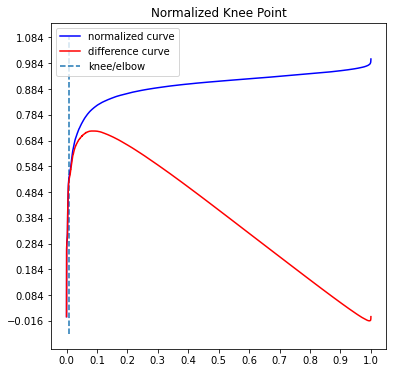

In [61]:
kneedle.plot_knee_normalized()

In [62]:
kneedle.knee_y

401.41050385938155

In [63]:
# Import the implementation of this algorihm from sklearn
from sklearn.cluster import DBSCAN

# Use the algorithm for outlier detection, the retun in clusters will show the membership of each point
# Any point labelled as -1 is an outlier

outlier_detection = DBSCAN(min_samples = 98, eps = 401)
clusters = outlier_detection.fit_predict(diabetes_df_copy_2)

# Count total number of outliers as count of those labelled as -1
total_outliers = list(clusters).count(-1)
print("Total number of outliers identified is: ",total_outliers)

Total number of outliers identified is:  6


## IsolationForest

In [48]:
# Import the implementation of this algorihm from sklearn
from sklearn.ensemble import IsolationForest

# Use the algorithm for outlier detection, then use it to predict each point
# Any point labelled as -1 is an outlier
clf = IsolationForest(max_samples=256, random_state = 1, contamination = 0.0468)
preds = clf.fit_predict(diabetes_df_copy_2)
print(preds)
total_outliers=0
for pred in preds:
    if pred == -1:
        total_outliers = total_outliers + 1
print("Total number of outliers identified is: ",total_outliers)

[ 1  1  1 ... -1  1  1]
Total number of outliers identified is:  3578


In [49]:
# Constructing a mask
newarray = (preds == -1)

# Filter outliers and new df without outliers
outliers_df = diabetes_df_copy_2[~newarray]
isolation_forest_outliers = diabetes_df_copy_2[newarray]

# Print the shape
print(outliers_df.shape)

(72869, 50)


## LocalOutlierFactor

Predicted outliers: 
 [ 1  1  1 ... -1  1  1]
Number of predicted outliers: 3578


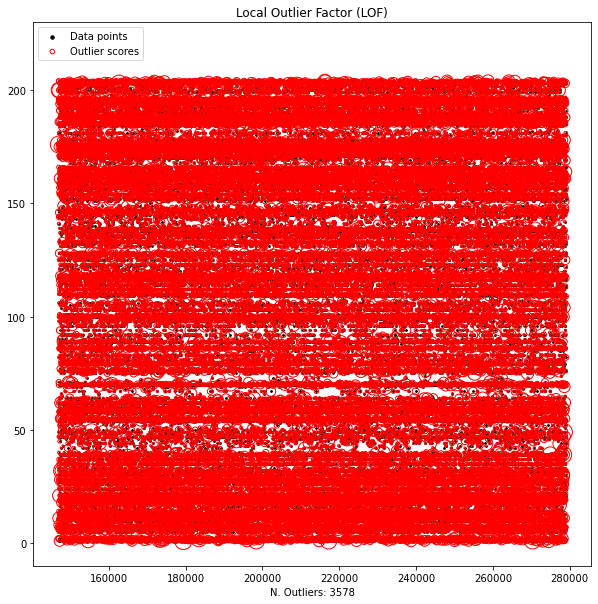

In [66]:
from sklearn.neighbors import LocalOutlierFactor
np.random.seed(1)

# fit the model for outlier detection (default)
clf = LocalOutlierFactor(n_neighbors=98, contamination=0.0468)

# use fit_predict to compute the predicted labels of the training samples
# (when LOF is used for outlier detection, the estimator has no predict,
# decision_function and score_samples methods).
y_pred = clf.fit_predict(diabetes_df_copy_2)

print ("Predicted outliers: \n",y_pred)

#Calculate number of outliers
outlierN = len([i for i in y_pred if i == -1])
print ("Number of predicted outliers:",outlierN)

#Let us see graphically how the outliers are identified
#Use outlier scores calculated by the algorithm to plot a circle around the outlier proportional to score.

X_scores = clf.negative_outlier_factor_

plt.figure(figsize=(10,10))
plt.title("Local Outlier Factor (LOF)")

#Convert the df to an array for the purpose of the scatterplot
Xol = diabetes_df_copy_2.to_numpy()

#Use scatter 
plt.scatter(Xol[:, 0], Xol[:, 1], color='k', s=3, label='Data points')

# plot circles with radius proportional to the outlier scores
radius = (X_scores.max() - X_scores) / (X_scores.max() - X_scores.min())
plt.scatter(Xol[:, 0], Xol[:, 1], s=500 * radius, edgecolors='r',
            facecolors='none', label='Outlier scores')
plt.axis('tight')
plt.ylim(-10,230)
plt.xlabel("N. Outliers: %d" % (outlierN))
legend = plt.legend(loc='upper left')
legend.legendHandles[0]._sizes = [12]
legend.legendHandles[1]._sizes = [20]
plt.show()

In [67]:
# Constructing a mask
newarray= (y_pred == -1)

# Filter outliers
LOF_outliers = diabetes_df_copy_2[newarray]

# Print the shape
print(diabetes_df_copy_2.shape)
print(LOF_outliers.shape)

(76447, 50)
(3578, 50)


## Scatterplots to see outliers

Text(0.5, 1.0, 'Scatter plot for LOF')

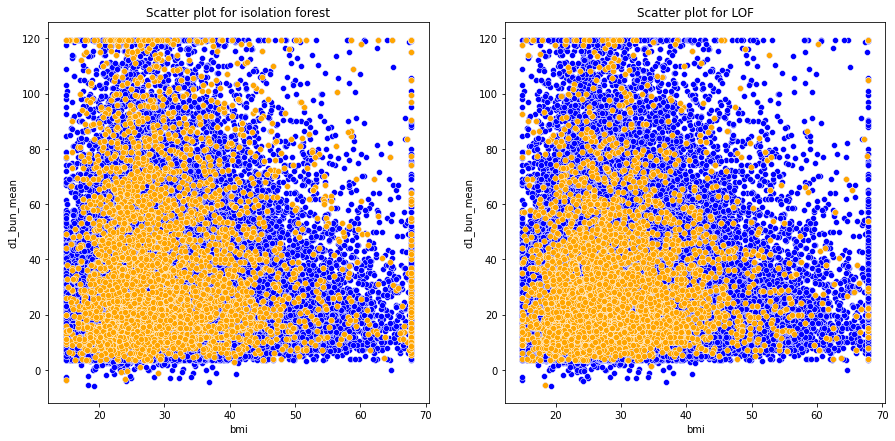

In [68]:
# Set the width and height of the figure
plt.figure(figsize=(15,7))

# Plot scatter for isolation forest
plt.subplot(1,2,1)
sns.scatterplot(x=diabetes_df_copy_2['bmi'], y=diabetes_df_copy_2['d1_bun_mean'],color='blue')
sns.scatterplot(x=isolation_forest_outliers['bmi'], y=isolation_forest_outliers['d1_bun_mean'],color='orange')
plt.title('Scatter plot for isolation forest')

# Plot scatterplot for LOF
plt.subplot(1,2,2)
sns.scatterplot(x=diabetes_df_copy_2['bmi'], y=diabetes_df_copy_2['d1_bun_mean'],color='blue')
sns.scatterplot(x=LOF_outliers['bmi'], y=LOF_outliers['d1_bun_mean'],color='orange')
plt.title('Scatter plot for LOF')

## KDE plots for outliers free data

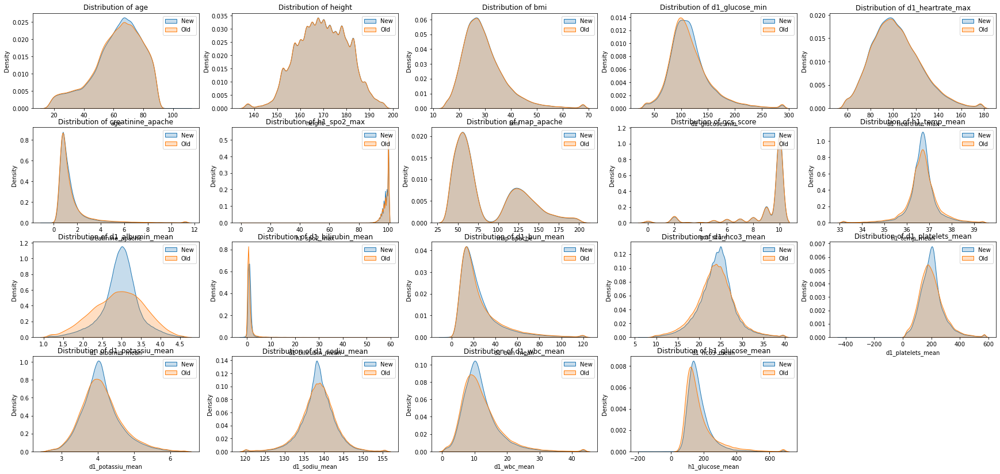

In [69]:
# New and old distribution after discarding outliers

KDEPlots(outliers_df, diabetes_df,7,5,'New','Old', numerical_columns)

## 2.2 Data pre-processing

## 2.2.1 Feature engineer

## 2.2.2 Feature selection

In [70]:
# id_columns = ['encounter_id','hospital_id']
# outliers_df.drop(id_columns, axis=1, inplace=True)
outliers_df.to_csv('cleaned_data.csv', encoding='utf-8', index=False)
print(outliers_df.shape)

(72869, 50)


## Train-test split => should not do sampling and FS on test data

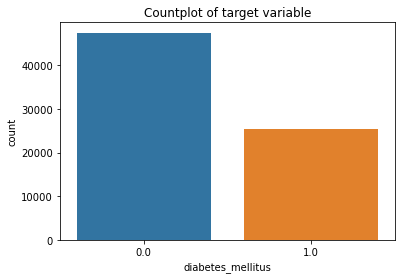

Value counts of target variables: 
0.0    47415
1.0    25454
Name: diabetes_mellitus, dtype: int64


In [71]:
# Countplot for target variable
sns.countplot(x='diabetes_mellitus',data=outliers_df)
plt.title('Countplot of target variable')
plt.show()

print(f"Value counts of target variables: \n{outliers_df['diabetes_mellitus'].value_counts()}")

=> should do train-test split with stratification

In [50]:
from sklearn.model_selection import train_test_split

# Specify features X and target variable y
X = outliers_df.loc[:,~outliers_df.columns.isin(['diabetes_mellitus','encounter_id'])]
y = outliers_df['diabetes_mellitus']

# Split train-test with stratification
train_X_all, test_X, train_y_all, test_y= train_test_split(X,y,test_size=0.3,random_state=1,stratify=y)

print(train_X_all.shape)
print(test_X.shape)
print(train_y_all.shape)
print(test_y.shape)

(51008, 48)
(21861, 48)
(51008,)
(21861,)


In [51]:
# Split train-validation with stratification
train_X, val_X, train_y, val_y= train_test_split(train_X_all,train_y_all,test_size=0.3,random_state=1,stratify=train_y_all)

print(train_X.shape)
print(val_X.shape)
print(train_y.shape)
print(val_y.shape)

(35705, 48)
(15303, 48)
(35705,)
(15303,)


## Balancing data => downsampling because we focus on detecting minorities

In [74]:
print(f"Value counts of target variables: \n{train_y.value_counts()}")

Value counts of target variables: 
0.0    23233
1.0    12472
Name: diabetes_mellitus, dtype: int64


In [52]:
from sklearn.utils import resample

# Separate majority and minority classes

df_train = pd.concat([train_X, train_y], axis=1)
df_majority = df_train[train_y == 0]
df_minority = df_train[train_y == 1]

# Downsample majority class
df_majority_downsampled = resample(df_majority, 
                                 replace=False,    # sample without replacement
                                 n_samples=12472,  # to match minority class
                                 random_state=1)   # reproducible results
    
# Combine minority class with downsampled majority class
df_downsampled = pd.concat([df_majority_downsampled, df_minority])
df_downsampled.to_csv('train_cleaned_data.csv', encoding='utf-8', index=False)

print(f"Value counts of target variables: \n{df_downsampled['diabetes_mellitus'].value_counts()}")

Value counts of target variables: 
0.0    12472
1.0    12472
Name: diabetes_mellitus, dtype: int64


## Feature selection

In [53]:
# Specify features X and target variable y
X = df_downsampled.loc[:,~df_downsampled.columns.isin(['diabetes_mellitus','encounter_id'])]
y = df_downsampled['diabetes_mellitus']

In [54]:
from sklearn.feature_selection import SelectKBest, f_classif

# Specify the features to consider.  
feature_cols = list(df_downsampled.columns)

# Keep all features but rank them by best f_classif score
selector = SelectKBest(f_classif, k='all')

# Fit and apply feature ranking method
new_X = selector.fit_transform(X, y)

# Retrieve the column names for the selected columns
names = X.columns.values[selector.get_support()]
# and their scores
scores = selector.scores_[selector.get_support()]
# pair the values together with the zip function
names_scores = list(zip(names, scores))
# Store the information in a data frame
ns_df = pd.DataFrame(data = names_scores, columns=['Feat_names', 'F_Scores'])
# Sort the dataframe for better visualization
ns_df_sorted = ns_df.sort_values(['F_Scores', 'Feat_names'], ascending = [False, True])
print(ns_df_sorted.to_string())
# Look at shape of new data
print(new_X.shape)
print(X.shape)

                     Feat_names     F_Scores
30              h1_glucose_mean  4358.588223
5                           bmi   980.730400
24                  d1_bun_mean   825.688342
35                    i_glucose   802.412608
9             creatinine_apache   578.494004
6                d1_glucose_min   530.385708
2                           age   247.054227
23            d1_bilirubin_mean   222.589931
27             d1_potassiu_mean   216.062034
47                  i_Neuro ICU    90.504695
31                 i_creatinine    70.616653
20                    gcs_score    65.475861
22              d1_albumin_mean    48.986755
28                d1_sodiu_mean    48.814464
38                  e_Caucasian    37.274007
36           e_African American    35.550961
25                 d1_hco3_mean    34.467964
26            d1_platelets_mean    30.701515
8              d1_heartrate_max    24.919400
33                    i_albumin    17.205697
42                      i_CSICU    17.068627
18  solid_

In [55]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import mutual_info_classif

# Keep all features but rank them by best mutual information score
selector = SelectKBest(score_func=mutual_info_classif, k='all')


# Fit and apply feature ranking method
X_new = selector.fit_transform(X, y)

# Retrieve the column names for the selected columns
names = X.columns.values[selector.get_support()]
# and their scores
scores = selector.scores_[selector.get_support()]
# pair the values together with the zip function
names_scores = list(zip(names, scores))
# Store the information in a data frame
ns_df = pd.DataFrame(data = names_scores, columns=['Feat_names', 'Mutual_info'])
# Sort the dataframe for better visualization
ns_df_sorted = ns_df.sort_values(['Mutual_info', 'Feat_names'], ascending = [False, True])
print(ns_df_sorted.to_string())
# Look at shape of new data
X_new.shape

                     Feat_names  Mutual_info
30              h1_glucose_mean     0.154294
6                d1_glucose_min     0.045161
24                  d1_bun_mean     0.029133
9             creatinine_apache     0.027980
5                           bmi     0.024501
23            d1_bilirubin_mean     0.020611
35                    i_glucose     0.019702
0                   hospital_id     0.018749
27             d1_potassiu_mean     0.016339
2                           age     0.013635
25                 d1_hco3_mean     0.006031
15            immunosuppression     0.005319
8              d1_heartrate_max     0.004563
37                      e_Asian     0.004384
28                d1_sodiu_mean     0.004190
38                  e_Caucasian     0.003467
10                  h1_spo2_max     0.003161
13                    cirrhosis     0.003158
36           e_African American     0.002641
7              intubated_apache     0.002603
21                 h1_temp_mean     0.002191
45        

(24944, 48)

In [58]:
# Transformers import
from sklearn.preprocessing import MinMaxScaler, Normalizer, PowerTransformer, QuantileTransformer, StandardScaler
from sklearn.decomposition import PCA

# Pipeline parameters imports
from sklearn.model_selection import ParameterGrid,RandomizedSearchCV,GridSearchCV
from sklearn.pipeline import Pipeline

## Benchmark before tuning hyperparameters

In [56]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix,plot_confusion_matrix,accuracy_score,f1_score,recall_score,precision_score,classification_report

# Defining classifiers

clf_nn = KNeighborsClassifier(n_neighbors=98)
clf_svm = SVC(kernel='poly', degree=3, random_state=1)
clf_tree = DecisionTreeClassifier(criterion='entropy', random_state=1)
clf_logit = LogisticRegression(random_state=1)
clf_mlp = MLPClassifier(random_state=1, max_iter=300)
clf_random = RandomForestClassifier(random_state=1)

# List the classifiers
clfs = [clf_nn, clf_svm, clf_tree, clf_logit, clf_mlp, clf_random]

# Fit classifiers to the data
for clf in clfs:
    clf.fit(X, y)

# Get the predictions for each classifier on the validation data
clf_preds = [clf.predict(val_X) for clf in clfs]

# Get the accuracy score for each classifer
accs = [accuracy_score(val_y, clf_p) for clf_p in clf_preds]
f1 = [f1_score(val_y, clf_p) for clf_p in clf_preds]
recall = [recall_score(val_y, clf_p) for clf_p in clf_preds]
precision = [precision_score(val_y, clf_p) for clf_p in clf_preds]

# Get the index of the best accuracy
index = np.argmax(accs)

print("Best classifier is:", clfs[index], "with:\n")
print('Accuracy:', accs[index])
print('F1 score:', f1[index])
print('Recall:', recall[index])
print('Precision:', precision[index])

np.sort(accs)

Best classifier is: MLPClassifier(max_iter=300, random_state=1) with:

Accuracy: 0.8249362870025485
F1 score: 0.7823190054440562
Recall: 0.9004863449307894
Precision: 0.6915673035483407


array([0.74861138, 0.76573221, 0.78415997, 0.79860158, 0.80369862,
       0.82493629])

## KNN

In [80]:
# Transformers import
from sklearn.preprocessing import MinMaxScaler, Normalizer, PowerTransformer, QuantileTransformer, StandardScaler
from sklearn.decomposition import PCA

# Pipeline parameters imports
from sklearn.model_selection import ParameterGrid,RandomizedSearchCV,GridSearchCV
from sklearn.pipeline import Pipeline

process = [("selector", SelectKBest()), ("transformer", StandardScaler()), ("clf", RandomForestClassifier)]

# Build the parameter grid

slt_params = [
    (SelectKBest, {"score_func": [f_classif,mutual_info_classif], "k": [k for k in range(10,22)]}),
    (PCA, {"n_components": [5,10,20]})
]

slts = [ctor(**para) for ctor, paras in slt_params for para in ParameterGrid(paras)]

trans = ["passthrough",StandardScaler(), MinMaxScaler(), Normalizer(), PowerTransformer(), QuantileTransformer()]

clf_params = [
    (KNeighborsClassifier, {"n_neighbors" : [k for k in range(90,100)],
    "weights": ['uniform','distance'],
    "algorithm": ['ball_tree','kd_tree','brute'],
    "p":[1,2]}),
]

clfs = [ctor(**para) for ctor, paras in clf_params for para in ParameterGrid(paras)]

params = dict(
    transformer = trans,
    selector = slts,
    clf = clfs,
)

# Use our pipeline and the parameter grid with RandomizedSearchCV (30 params settings)
clf = RandomizedSearchCV(Pipeline(process), params, n_iter=30)
clf.fit(X, y);

# Show the best parameters
print(clf.best_params_)

# Collect predictions on validation data
y_hat = clf.predict(val_X)

# Print classification report

print(classification_report(val_y, y_hat))

{'transformer': PowerTransformer(), 'selector': SelectKBest(k=12), 'clf': KNeighborsClassifier(algorithm='ball_tree', n_neighbors=96, p=1,
                     weights='distance')}
              precision    recall  f1-score   support

         0.0       0.86      0.76      0.81      9957
         1.0       0.64      0.77      0.70      5346

    accuracy                           0.77     15303
   macro avg       0.75      0.77      0.75     15303
weighted avg       0.78      0.77      0.77     15303



## SVM

In [57]:
process = [("selector", SelectKBest()), ("transformer", StandardScaler()), ("clf", RandomForestClassifier)]

# Build the parameter grid

slt_params = [
    (SelectKBest, {"score_func": [f_classif,mutual_info_classif], "k": [k for k in range(10,22)]}),
    (PCA, {"n_components": [5,10,20]})
]

slts = [ctor(**para) for ctor, paras in slt_params for para in ParameterGrid(paras)]
     
clf_params = [
    (SVC, {"kernel": ["linear","poly", "rbf", "sigmoid", "precomputed"], "C": [0.1, 1.0, 10]}),
]

clfs = [ctor(**para) for ctor, paras in clf_params for para in ParameterGrid(paras)]

trans = ["passthrough",StandardScaler(), MinMaxScaler(), Normalizer(), PowerTransformer(), QuantileTransformer()]

params = dict(
    transformer = trans,
    selector = slts,
    clf = clfs
)

# Use our pipeline and the parameter grid with RandomizedSearchCV
clf = RandomizedSearchCV(Pipeline(process), params)
clf.fit(X, y);

# Show the best parameters
print(clf.best_params_)

# Collect predictions on validation data
y_hat = clf.predict(val_X)

# Print classification report

print(classification_report(val_y, y_hat))

NameError: name 'StandardScaler' is not defined

## Decision Tree

In [82]:
process = [("selector", SelectKBest()), ("transformer", StandardScaler()), ("clf", RandomForestClassifier)]

# Build the parameter grid

slt_params = [
    (SelectKBest, {"score_func": [f_classif,mutual_info_classif], "k": [k for k in range(10,22)]}),
    (PCA, {"n_components": [5,10,20]})
]

slts = [ctor(**para) for ctor, paras in slt_params for para in ParameterGrid(paras)]
     
clf_params = [
    (DecisionTreeClassifier, {"criterion": ["gini", "entropy"]}),
]
            
clfs = [ctor(**para) for ctor, paras in clf_params for para in ParameterGrid(paras)]

trans = ["passthrough",StandardScaler(), MinMaxScaler(), Normalizer(), PowerTransformer(), QuantileTransformer()]

params = dict(
    transformer = trans,
    selector = slts,
    clf = clfs
)

# Use our pipeline and the parameter grid with RandomizedSearchCV
clf = RandomizedSearchCV(Pipeline(process), params)
clf.fit(X, y);

# Show the best parameters
print(clf.best_params_)

# Collect predictions on validation data
y_hat = clf.predict(val_X)

# Print classification report

print(classification_report(val_y, y_hat))

{'transformer': QuantileTransformer(), 'selector': SelectKBest(k=20), 'clf': DecisionTreeClassifier()}
              precision    recall  f1-score   support

         0.0       0.84      0.75      0.79      9957
         1.0       0.61      0.74      0.67      5346

    accuracy                           0.74     15303
   macro avg       0.73      0.74      0.73     15303
weighted avg       0.76      0.74      0.75     15303



## LogisticRegression

In [83]:
process = [("selector", SelectKBest()), ("transformer", StandardScaler()), ("clf", RandomForestClassifier)]

# Build the parameter grid

slt_params = [
    (SelectKBest, {"score_func": [f_classif,mutual_info_classif], "k": [k for k in range(10,12)]}),
    (PCA, {"n_components": [5,10,20]})
]

slts = [ctor(**para) for ctor, paras in slt_params for para in ParameterGrid(paras)]
     
clf_params = [
    (LogisticRegression, {"penalty" : ["l1", "l2", "elasticnet", "none"], "C": [0.1, 1, 10]}),
]
            
clfs = [ctor(**para) for ctor, paras in clf_params for para in ParameterGrid(paras)]

trans = ["passthrough",StandardScaler(), MinMaxScaler(), Normalizer(), PowerTransformer(), QuantileTransformer()]

params = dict(
    transformer = trans,
    selector = slts,
    clf = clfs
)

# Use our pipeline and the parameter grid with RandomizedSearchCV
clf = RandomizedSearchCV(Pipeline(process), params)
clf.fit(X, y);

# Show the best parameters
print(clf.best_params_)

# Collect predictions on validation data
y_hat = clf.predict(val_X)

# Print classification report

print(classification_report(val_y, y_hat))

{'transformer': MinMaxScaler(), 'selector': SelectKBest(k=11), 'clf': LogisticRegression(C=1, penalty='none')}
              precision    recall  f1-score   support

         0.0       0.85      0.80      0.83      9957
         1.0       0.66      0.75      0.70      5346

    accuracy                           0.78     15303
   macro avg       0.76      0.77      0.76     15303
weighted avg       0.79      0.78      0.78     15303



## MLP

In [84]:
process = [("selector", SelectKBest()), ("transformer", StandardScaler()), ("clf", RandomForestClassifier)]

# Build the parameter grid

slt_params = [
    (SelectKBest, {"score_func": [f_classif,mutual_info_classif], "k": [k for k in range(10,22)]}),
    (PCA, {"n_components": [5,10,20]})
]

slts = [ctor(**para) for ctor, paras in slt_params for para in ParameterGrid(paras)]
     
clf_params = [
    (MLPClassifier, {
    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,50,50)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive'],
        }
    ),
]
            
clfs = [ctor(**para) for ctor, paras in clf_params for para in ParameterGrid(paras)]

trans = ["passthrough",StandardScaler(), MinMaxScaler(), Normalizer(), PowerTransformer(), QuantileTransformer()]

params = dict(
    transformer = trans,
    selector = slts,
    clf = clfs
)

# Use our pipeline and the parameter grid with RandomizedSearchCV
clf = RandomizedSearchCV(Pipeline(process), params)
clf.fit(X, y);

# Show the best parameters
print(clf.best_params_)

# Collect predictions on validation data
y_hat = clf.predict(val_X)

# Print classification report

print(classification_report(val_y, y_hat))

{'transformer': QuantileTransformer(), 'selector': SelectKBest(k=20), 'clf': MLPClassifier(hidden_layer_sizes=(50, 100, 50), learning_rate='adaptive',
              solver='sgd')}
              precision    recall  f1-score   support

         0.0       0.93      0.78      0.85      9957
         1.0       0.69      0.89      0.78      5346

    accuracy                           0.82     15303
   macro avg       0.81      0.84      0.81     15303
weighted avg       0.84      0.82      0.82     15303



## RandomForestClassifier

In [85]:
process = [("selector", SelectKBest()), ("transformer", StandardScaler()), ("clf", RandomForestClassifier)]

# Build the parameter grid

slt_params = [
    (SelectKBest, {"score_func": [f_classif,mutual_info_classif], "k": [k for k in range(10,22)]}),
    (PCA, {"n_components": [5,10,20]})
]

slts = [ctor(**para) for ctor, paras in slt_params for para in ParameterGrid(paras)]
     
clf_params = [
    (RandomForestClassifier, {"criterion": ["gini", "entropy"], "n_estimators": [200]}),
]
            
clfs = [ctor(**para) for ctor, paras in clf_params for para in ParameterGrid(paras)]

trans = ["passthrough",StandardScaler(), MinMaxScaler(), Normalizer(), PowerTransformer(), QuantileTransformer()]

params = dict(
    transformer = trans,
    selector = slts,
    clf = clfs
)

# Use our pipeline and the parameter grid with RandomizedSearchCV
clf = RandomizedSearchCV(Pipeline(process), params)
clf.fit(X, y);

# Show the best parameters
print(clf.best_params_)

# Collect predictions on validation data
y_hat = clf.predict(val_X)

# Print classification report

print(classification_report(val_y, y_hat))

{'transformer': QuantileTransformer(), 'selector': SelectKBest(k=21), 'clf': RandomForestClassifier(n_estimators=200)}
              precision    recall  f1-score   support

         0.0       0.90      0.79      0.84      9957
         1.0       0.68      0.83      0.75      5346

    accuracy                           0.81     15303
   macro avg       0.79      0.81      0.79     15303
weighted avg       0.82      0.81      0.81     15303



## Test models on test set

In [59]:
# Specify chosen classifiers with tuned parameters
clf_nn = Pipeline([('transformer', PowerTransformer()), ('selector', SelectKBest(k=12)), ('clf', KNeighborsClassifier(algorithm='ball_tree', n_neighbors=96, p=1))])
clf_svm = Pipeline([('transformer', PowerTransformer()), ('selector', SelectKBest(k=19)), ('clf', SVC(probability=True,random_state=1))])
clf_tree = Pipeline([('transformer', QuantileTransformer()), ('selector', SelectKBest(k=20)), ('clf', DecisionTreeClassifier(random_state=1))])
clf_logit = Pipeline([('transformer', MinMaxScaler()), ('selector', SelectKBest(k=11)), ('clf', LogisticRegression(C=1, penalty='none',random_state=1))])
clf_mlp = Pipeline([('transformer', QuantileTransformer()), ('selector', SelectKBest(k=20)), ('clf', MLPClassifier(hidden_layer_sizes=(50, 100, 50), learning_rate='adaptive',random_state=1))])
clf_random = Pipeline([('transformer', QuantileTransformer()), ('selector', SelectKBest(k=21)), ('clf', RandomForestClassifier(n_estimators=200,random_state=1))])

# List the classifiers
clfs = [clf_nn, clf_svm, clf_tree, clf_logit, clf_mlp, clf_random]

# Fit the classifiers to the data
for clf in clfs:
    clf.fit(X, y)

# Get the predictions for each classifier
clf_preds = [clf.predict(test_X) for clf in clfs]

# Get the accuracy,f1,recall,precision score for each classifer
accs = [accuracy_score(test_y, clf_p) for clf_p in clf_preds]
f1 = [f1_score(test_y, clf_p) for clf_p in clf_preds]
recall = [recall_score(test_y, clf_p) for clf_p in clf_preds]
precision = [precision_score(test_y, clf_p) for clf_p in clf_preds]

# Get the index of the best accuracy
index = np.argmax(accs)

print("Best classifier is:", clfs[index], "with:\n")
print('Accuracy:', accs[index])
print('F1 score:', f1[index])
print('Recall:', recall[index])
print('Precision:', precision[index])

np.sort(accs)

Best classifier is: Pipeline(steps=[('transformer', PowerTransformer()),
                ('selector', SelectKBest(k=19)),
                ('clf', SVC(probability=True, random_state=1))]) with:

Accuracy: 0.8462101459219615
F1 score: 0.8000951361636343
Recall: 0.8810895756940806
Precision: 0.73273796558484


array([0.74699236, 0.7669823 , 0.7836787 , 0.80655048, 0.81524175,
       0.84621015])

## Confusion matrix of SVC classifier

              precision    recall  f1-score   support

         0.0       0.93      0.83      0.88     14225
         1.0       0.73      0.88      0.80      7636

    accuracy                           0.85     21861
   macro avg       0.83      0.85      0.84     21861
weighted avg       0.86      0.85      0.85     21861



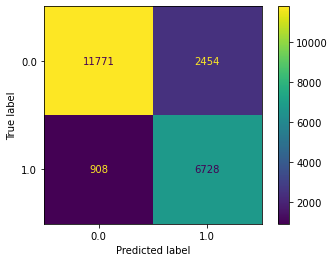

In [60]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

# Fit train data and predict test data
clf_svm.fit(X, y)
clf_preds = clf_svm.predict(test_X)

# Print results
print(classification_report(test_y, clf_preds))

# Making the Confusion Matrix
cm = confusion_matrix(test_y, clf_preds)

# Plot it
plot_confusion_matrix(clf_svm, test_X, test_y)

## AUROC of SVC classifier

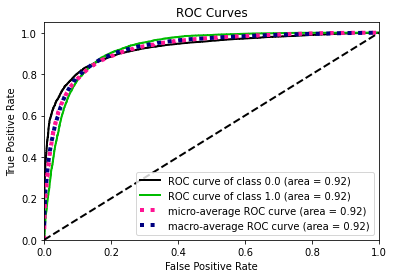

In [61]:
import scikitplot as skplt
from sklearn.metrics import plot_roc_curve
from sklearn.metrics import roc_auc_score

# Fitting the model 
clf_svm.fit(X, y) 
y_true, y_pred = test_y, clf_svm.predict(test_X)
y_probas = clf_svm.predict_proba(test_X)
# Plot ROC
skplt.metrics.plot_roc_curve(y_true, y_probas)
plt.show()

## Unsupervised clustering algorithm (K-means, or hierarchical)

## Visualizing clusters on validation dataset

In [62]:
clustering_data = pd.concat([val_X,val_y], axis=1)
clustering_data.reset_index(drop=True,inplace=True)
clustering_data

,hospital_id,gender,age,elective_surgery,height,bmi,d1_glucose_min,intubated_apache,d1_heartrate_max,creatinine_apache,...,e_Hispanic,e_Native American,i_CCU-CTICU,i_CSICU,i_CTICU,i_Cardiac ICU,i_MICU,i_Med-Surg ICU,i_Neuro ICU,diabetes_mellitus
0,163.0,0.0,43.0,0.0,160.00,25.429688,166.0,0.0,116.0,0.731697,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,118.0,1.0,85.0,0.0,177.80,31.569451,141.0,0.0,84.0,2.240000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,137.0,0.0,72.0,0.0,157.48,34.201681,168.0,0.0,72.0,0.620000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,161.0,1.0,60.0,1.0,163.00,29.357522,130.0,0.0,118.0,0.640000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,165.0,1.0,44.0,0.0,175.30,25.837868,99.0,0.0,147.0,3.310000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15298,81.0,1.0,82.0,1.0,170.20,33.554220,106.0,0.0,87.0,1.020000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
15299,19.0,0.0,38.0,0.0,170.00,29.653979,84.0,0.0,96.0,1.568569,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
15300,46.0,1.0,40.0,0.0,185.40,30.256165,117.0,0.0,144.0,0.860000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
15301,175.0,1.0,83.0,0.0,183.00,19.707964,111.0,1.0,150.0,1.730000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [63]:
visualize_columns = numerical_columns.copy()
visualize_columns.remove('gcs_score')
visualize_columns.append('diabetes_mellitus')
visualize_columns

['age',
 'height',
 'bmi',
 'd1_glucose_min',
 'd1_heartrate_max',
 'creatinine_apache',
 'h1_spo2_max',
 'map_apache',
 'h1_temp_mean',
 'd1_albumin_mean',
 'd1_bilirubin_mean',
 'd1_bun_mean',
 'd1_hco3_mean',
 'd1_platelets_mean',
 'd1_potassiu_mean',
 'd1_sodiu_mean',
 'd1_wbc_mean',
 'h1_glucose_mean',
 'diabetes_mellitus']

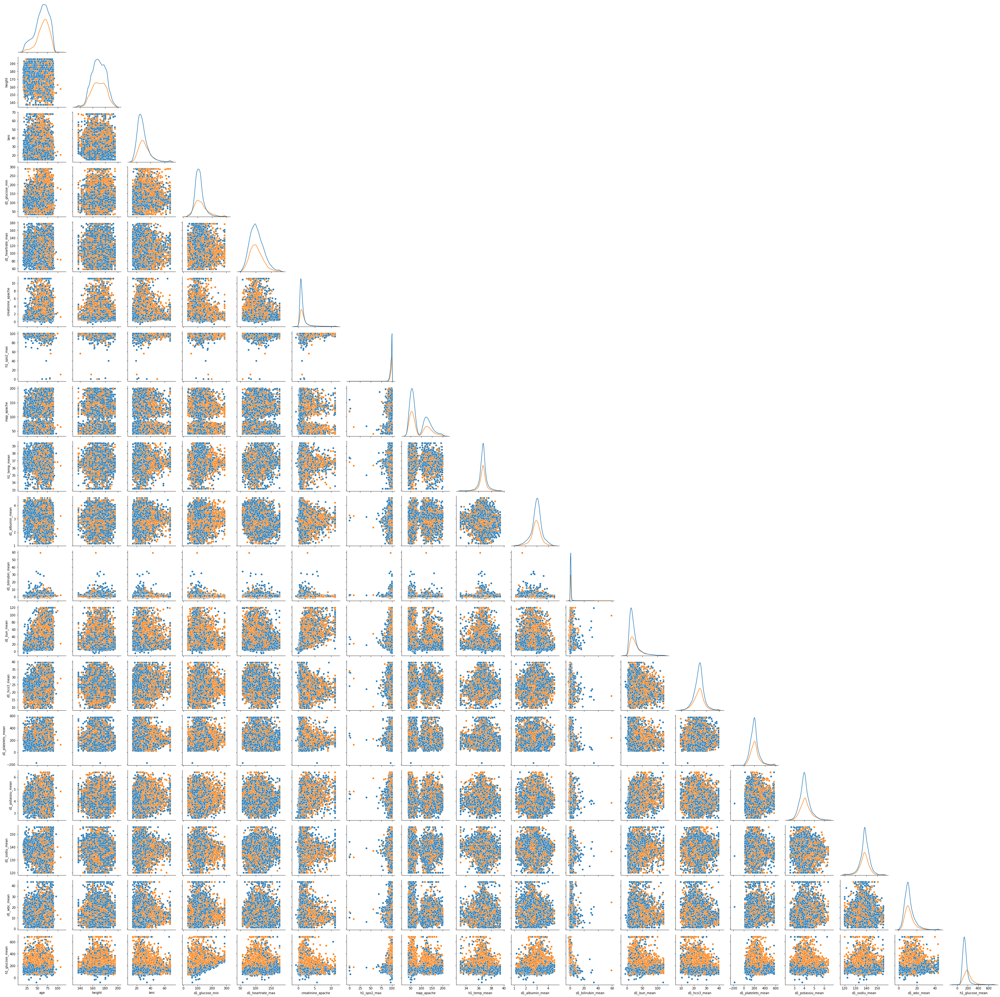

In [176]:
g = sns.PairGrid(data=clustering_data[visualize_columns], hue='diabetes_mellitus',diag_sharey=False, corner=True)

g.map_lower(sns.scatterplot)
g.map_diag(sns.kdeplot)

In [155]:
visualize_columns.remove('diabetes_mellitus')
visualize_columns.remove('h1_glucose_mean')

['age',
 'height',
 'bmi',
 'd1_glucose_min',
 'd1_heartrate_max',
 'creatinine_apache',
 'h1_spo2_max',
 'map_apache',
 'h1_temp_mean',
 'd1_albumin_mean',
 'd1_bilirubin_mean',
 'd1_bun_mean',
 'd1_hco3_mean',
 'd1_platelets_mean',
 'd1_potassiu_mean',
 'd1_sodiu_mean',
 'd1_wbc_mean']

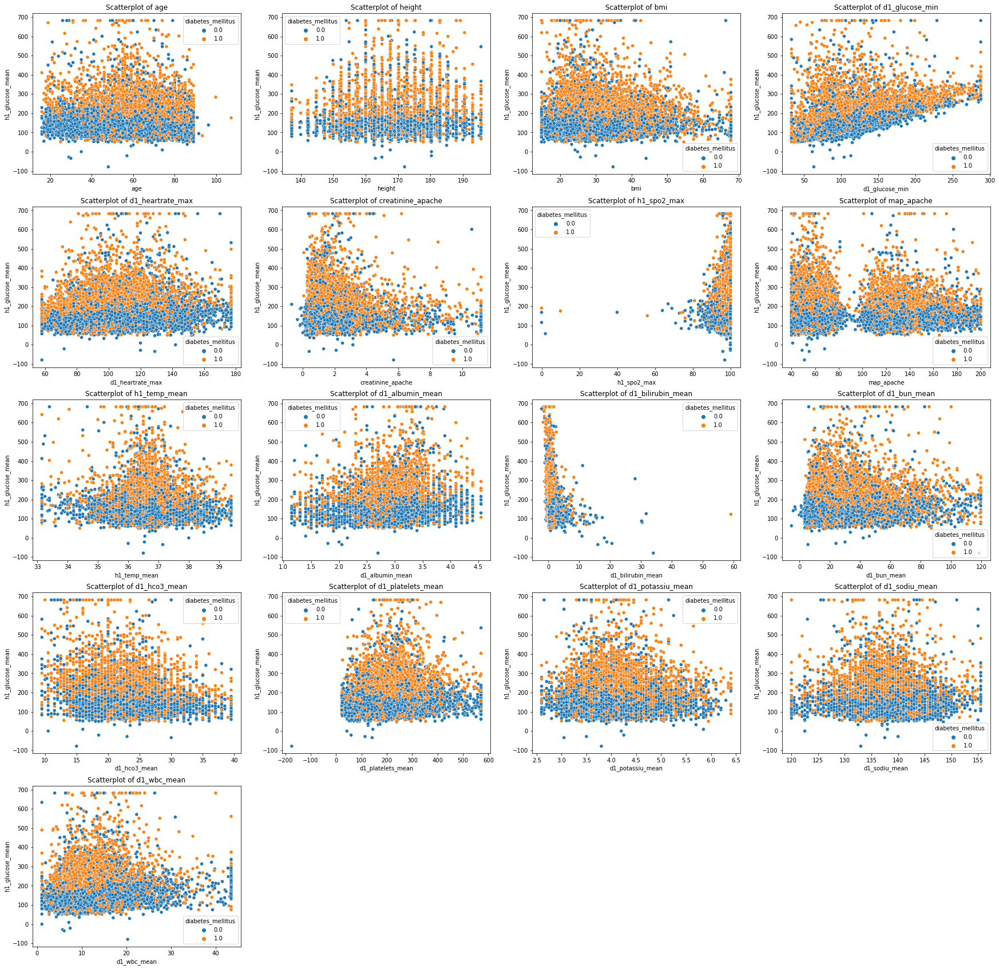

In [162]:
def SCATPlots(df, rows, cols, columns):
    """ Make scatterplots for min and max"""
     # Add figure box
    plt.figure(figsize=(30,30))
    i=1
    for column in columns:
        plt.subplot(rows,cols,i)
        sns.scatterplot(x = df[column] , y = df['h1_glucose_mean'], hue = df['diabetes_mellitus'])
        plt.title(f'Scatterplot of {column}')
        i+=1

SCATPlots(clustering_data,5,4,visualize_columns)

# K-means Clustering

## PCA for dimension reduction

Text(0, 0.5, 'Cumulative Explained Variance')

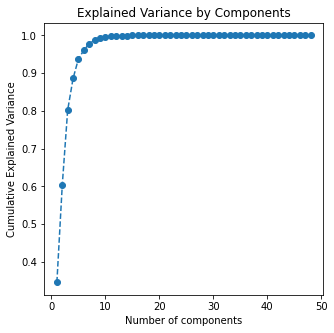

In [64]:
# Fit in to the validation data
pca = PCA()
pca.fit(val_X)

# pca.explained_variance_ratio_

# Plot to find the optimum number of features from PCA
plt.figure(figsize=(5,5))
plt.plot(range(1,49), pca.explained_variance_ratio_.cumsum(), marker = 'o', linestyle = '--')
plt.title('Explained Variance by Components')
plt.xlabel('Number of components')
plt.ylabel('Cumulative Explained Variance')

In [65]:
# Chosen 8 principle components for the dataset
pca = PCA(8)
val_X_pca = pca.fit(val_X)
val_X_pca = pca.transform(val_X)
val_X_pca

array([[ 67.55785858,  49.59777403, -55.24647341, ...,  18.97620871,
        -14.73420224,   6.52809303],
       [-70.29136978,  -9.5947723 , -11.30906034, ..., -22.23141381,
         17.58171769,  -0.10238922],
       [ -0.6036418 ,  16.24276057, -30.44254374, ..., -27.25940499,
        -13.74014277,  -9.70384972],
       ...,
       [-60.69497873,  75.88907433,  66.4254633 , ...,  46.41347938,
        -10.23417634,   8.81286809],
       [ 27.42282265, -50.25272231, -71.83633423, ...,  36.57126161,
         40.61041861,  -9.38939083],
       [ 72.45797018, -55.90542558, -59.53899345, ...,  -4.6619255 ,
        -20.96934713,  -3.13406188]])

# Elbow method

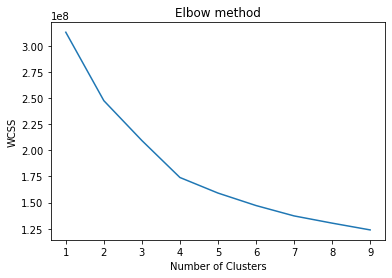

In [66]:
# Using the elbow method to find the optimal number of clusters
from sklearn.cluster import KMeans
wcss = []

kmeans_models = [KMeans(n_clusters=k).fit(val_X_pca) for k in range (1, 10)]
innertia = [model.inertia_ for model in kmeans_models]

plt.plot(range(1, 10), innertia)
plt.title('Elbow method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

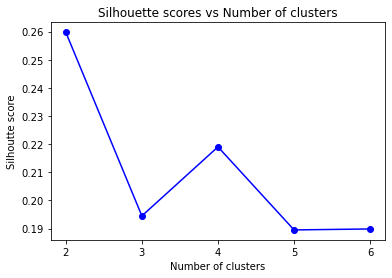

In [67]:
from sklearn.metrics import silhouette_score

silhoutte_scores = [silhouette_score(val_X_pca, model.labels_) for model in kmeans_models[1:6]]
plt.plot(range(2,7), silhoutte_scores, "bo-")
plt.xticks([2, 3, 4, 5, 6])
plt.title('Silhouette scores vs Number of clusters')
plt.xlabel('Number of clusters')
plt.ylabel('Silhoutte score')
plt.show()

In [68]:
from sklearn.metrics import silhouette_score

kmeans = KMeans(n_clusters=2, random_state=1)
kmeans.fit(val_X_pca)

print('Silhoutte score of our model is ' + str(silhouette_score(val_X_pca, kmeans.labels_)))

Silhoutte score of our model is 0.25977213952300676


In [69]:
# Fitting K-Means to the dataset
kmeans = KMeans(n_clusters = 2, init = 'k-means++', random_state = 1)

y_kmeans = kmeans.fit_predict(val_X_pca)

In [70]:
# Concatenate 8 PCA components and K_means segmentation variable to the validation dataset
val_X_pca_kmeans = pd.concat([val_X.reset_index(drop=True), pd.DataFrame(val_X_pca)], axis=1)
val_X_pca_kmeans.columns.values[-8:] = ['Component 1','Component 2','Component 3','Component 4','Component 5','Component 6','Component 7','Component 8']

val_X_pca_kmeans['Segmentation K-means'] = kmeans.labels_

In [71]:
val_X_pca_kmeans

,hospital_id,gender,age,elective_surgery,height,bmi,d1_glucose_min,intubated_apache,d1_heartrate_max,creatinine_apache,...,i_Neuro ICU,Component 1,Component 2,Component 3,Component 4,Component 5,Component 6,Component 7,Component 8,Segmentation K-means
0,163.0,0.0,43.0,0.0,160.00,25.429688,166.0,0.0,116.0,0.731697,...,0.0,67.557859,49.597774,-55.246473,-28.930826,-31.884253,18.976209,-14.734202,6.528093,0
1,118.0,1.0,85.0,0.0,177.80,31.569451,141.0,0.0,84.0,2.240000,...,0.0,-70.291370,-9.594772,-11.309060,-36.005803,-45.697369,-22.231414,17.581718,-0.102389,1
2,137.0,0.0,72.0,0.0,157.48,34.201681,168.0,0.0,72.0,0.620000,...,0.0,-0.603642,16.242761,-30.442544,57.777008,-46.355350,-27.259405,-13.740143,-9.703850,1
3,161.0,1.0,60.0,1.0,163.00,29.357522,130.0,0.0,118.0,0.640000,...,0.0,-11.527939,-21.082630,-55.797969,-21.014807,-24.058184,21.006320,-5.553911,-6.705348,1
4,165.0,1.0,44.0,0.0,175.30,25.837868,99.0,0.0,147.0,3.310000,...,0.0,288.853594,400.152124,-38.965773,-53.127433,153.672929,16.184305,-3.083082,-4.227454,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15298,81.0,1.0,82.0,1.0,170.20,33.554220,106.0,0.0,87.0,1.020000,...,0.0,26.206589,-29.913757,23.128492,-13.233266,3.560055,-19.693310,0.591295,-16.175715,1
15299,19.0,0.0,38.0,0.0,170.00,29.653979,84.0,0.0,96.0,1.568569,...,0.0,-4.281695,-60.601308,84.194465,-32.085821,15.686878,3.175739,-21.301039,14.842086,1
15300,46.0,1.0,40.0,0.0,185.40,30.256165,117.0,0.0,144.0,0.860000,...,0.0,-60.694979,75.889074,66.425463,28.831094,12.059704,46.413479,-10.234176,8.812868,1
15301,175.0,1.0,83.0,0.0,183.00,19.707964,111.0,1.0,150.0,1.730000,...,0.0,27.422823,-50.252722,-71.836334,-47.139115,-6.654726,36.571262,40.610419,-9.389391,1


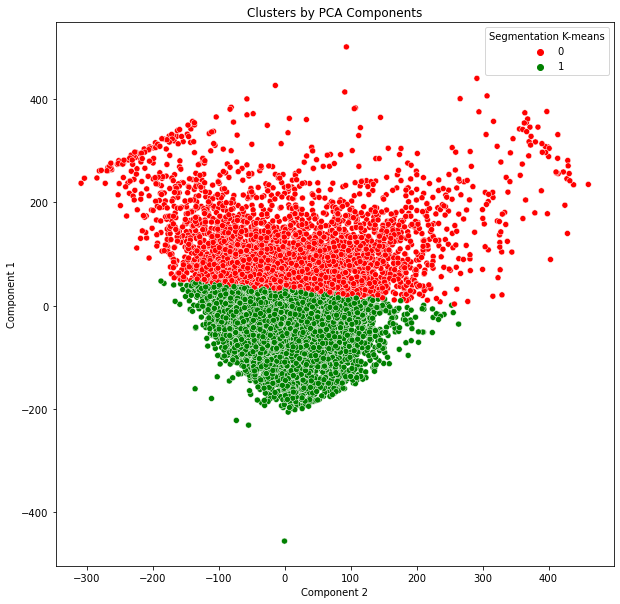

In [254]:
# Plot data by PCA components. The Y axis is the first component, X axis is the second
x_axis = val_X_pca_kmeans['Component 2']
y_axis = val_X_pca_kmeans['Component 1']
plt.figure(figsize=(10,10))
sns.scatterplot(x_axis, y_axis, hue = val_X_pca_kmeans['Segmentation K-means'], palette = ['r','g'])
plt.title('Clusters by PCA Components')
plt.show()

Text(0.5, 1.0, 'True labels by PCA Components')

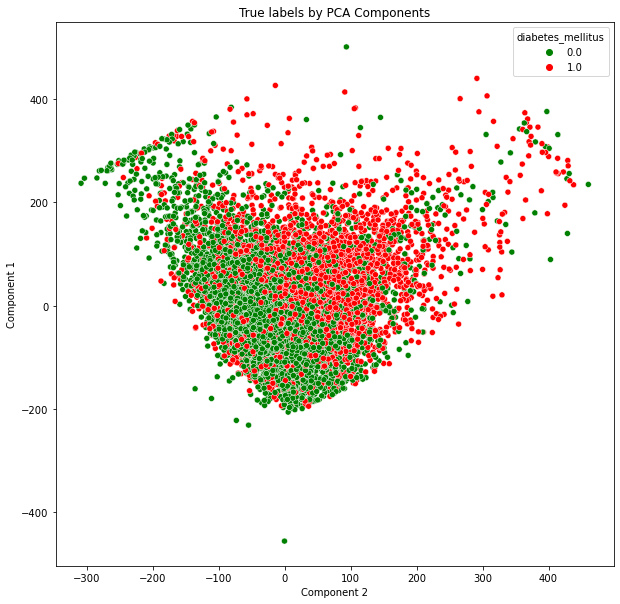

In [256]:
# Plot of true labels on original data

plt.figure(figsize=(10,10))
sns.scatterplot(x_axis, y_axis, hue = clustering_data['diabetes_mellitus'], palette = ['g','r'])
plt.title('True labels by PCA Components')

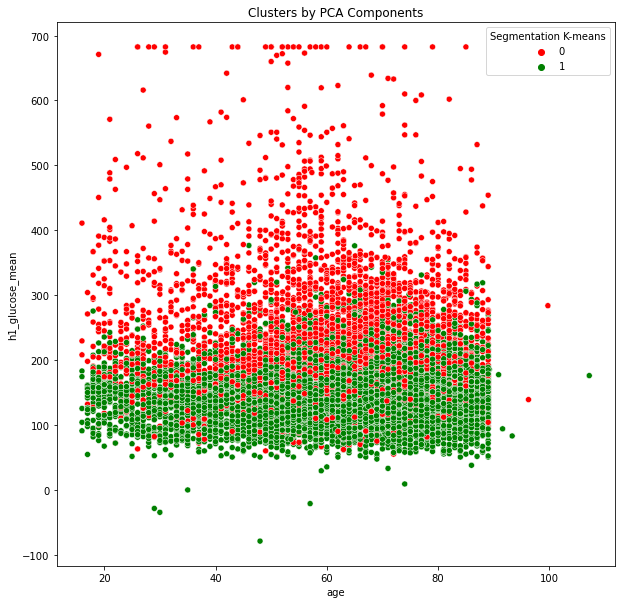

In [257]:
# Plot of clustering labels on original data with k-means and pca

plt.figure(figsize=(10,10))
sns.scatterplot(x = clustering_data['age'], y = clustering_data['h1_glucose_mean'], hue = val_X_pca_kmeans['Segmentation K-means'], palette = ['r','g'])
plt.title('Clusters by true features')
plt.show()

Text(0.5, 1.0, 'True labels by true features')

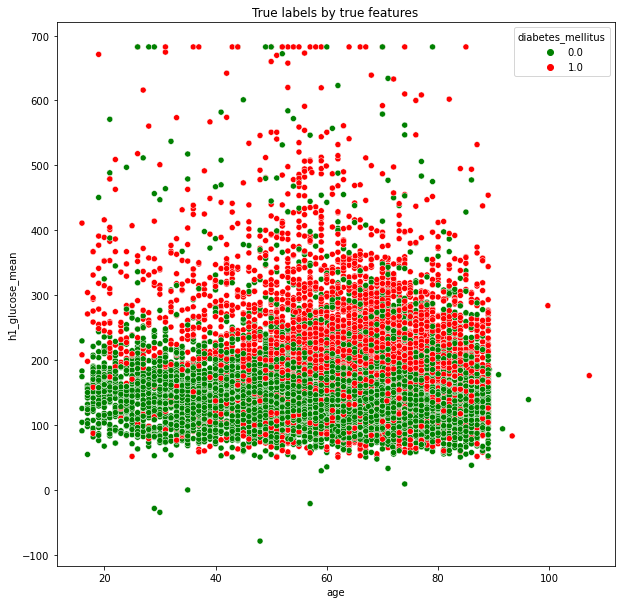

In [258]:
# Plot of true labels on original data
plt.figure(figsize=(10,10))
sns.scatterplot(x = clustering_data['age'], y = clustering_data['h1_glucose_mean'], hue = clustering_data['diabetes_mellitus'], palette = ['g','r'])
plt.title('True labels by true features')

## K-means cluster visualize

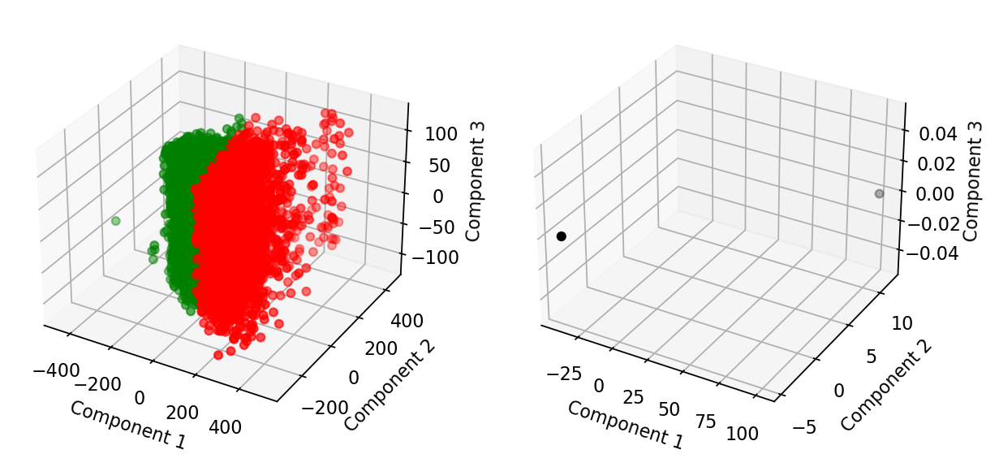

In [72]:
from mpl_toolkits.mplot3d import Axes3D  

import matplotlib.pyplot as plt
colors = ["red", "green"]


fig = plt.figure(figsize=(14, 6), dpi=160)
ax = fig.add_subplot(1,3,1, projection='3d')
ax1 = fig.add_subplot(1,3,2, projection='3d')

#map the colors to the labels
colors_map = list(map(lambda l: colors[l], y_kmeans))

ax.scatter(val_X_pca[:,0], val_X_pca[:,1], val_X_pca[:,2], c=colors_map)
ax.set_xlabel("Component 1")
ax.set_ylabel("Component 2")
ax.set_zlabel("Component 3")

#plot the 3 cluster centres
flat_c= ["black","black"]
C = kmeans.cluster_centers_

ax1.scatter(C[:,0], C[:,1], c=flat_c)
ax1.set_xlabel("Component 1")
ax1.set_ylabel("Component 2")
ax1.set_zlabel("Component 3")

plt.show()

# K-means evaluation

In [73]:
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.metrics.cluster import adjusted_mutual_info_score


score_AMI = adjusted_mutual_info_score(val_y, y_kmeans)
score_ARI = adjusted_rand_score(val_y, y_kmeans)

print("Adjusted Mutual Information score:", score_AMI)
print("Adjusted Rand Index score: ", score_ARI)

Adjusted Mutual Information score: 0.04303727442647733
Adjusted Rand Index score:  0.09453613918932233


# Hierachical Clustering

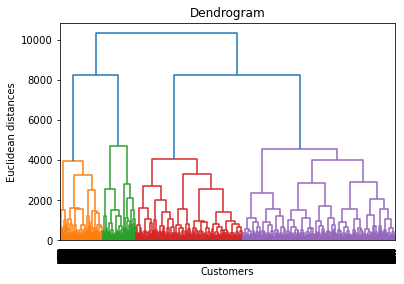

In [269]:
# Using the dendrogram to find the optimal number of clusters
import scipy.cluster.hierarchy as sch
dendrogram = sch.dendrogram(sch.linkage(val_X_pca, method = 'ward'))
plt.title('Dendrogram')
plt.xlabel('Customers')
plt.ylabel('Euclidean distances')
plt.show()

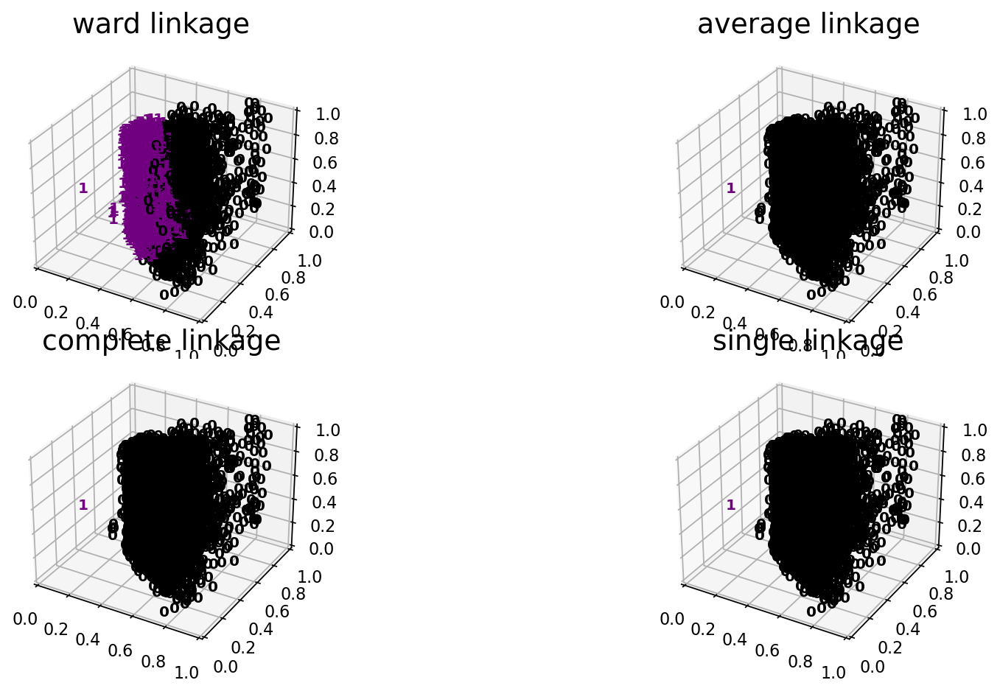

In [304]:
def plot_clustering(X_data, labels, title=None, ax=None):
    x_min, x_max = np.min(X_data, axis=0), np.max(X_data, axis=0)
    X_data = (X_data - x_min) / (x_max - x_min)


    for i in range(X_data.shape[0]):
        ax.text(X_data[i, 0], X_data[i, 1], X_data[i,2], str(labels[i]),
                 color=plt.cm.nipy_spectral(labels[i] / 20.),
                 fontdict={'weight': 'bold', 'size': 9})

    if title is not None:
        ax.set_title(title, size=17)

from sklearn.cluster import AgglomerativeClustering

from mpl_toolkits.mplot3d import Axes3D  

fig = plt.figure(figsize=(14, 6), dpi=160)
ax = fig.add_subplot(2,2,1, projection='3d')
ax1 = fig.add_subplot(2,2,2, projection='3d')
ax2 = fig.add_subplot(2,2,3, projection='3d')
ax3 = fig.add_subplot(2,2,4, projection='3d')

fig.tight_layout(rect=[0, 0.03, 1, 0.95])

for ax_, linkage in zip( (ax,ax1,ax2,ax3),('ward', 'average', 'complete', 'single')):
    clustering = AgglomerativeClustering(linkage=linkage, n_clusters=2)
    clustering.fit(val_X_pca)
    plot_clustering(val_X_pca, clustering.labels_, "%s linkage" % linkage, ax_)

In [305]:
from sklearn.cluster import FeatureAgglomeration

# Use Feature Agglomeration to reduce features into 2
agglo = FeatureAgglomeration(n_clusters = 2,linkage="ward")
agglo.fit(val_X_pca)

X_reduced = agglo.transform(val_X_pca)

k_means = KMeans(2)
k_means.fit(X_reduced)

labels_pred = k_means.predict(X_reduced)
print(labels_pred)

[1 0 0 ... 0 0 1]


In [322]:
le = LabelEncoder()
encoding = val_y.copy()
encoding = le.fit_transform(encoding)
encoding

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

# Visualizing clusters

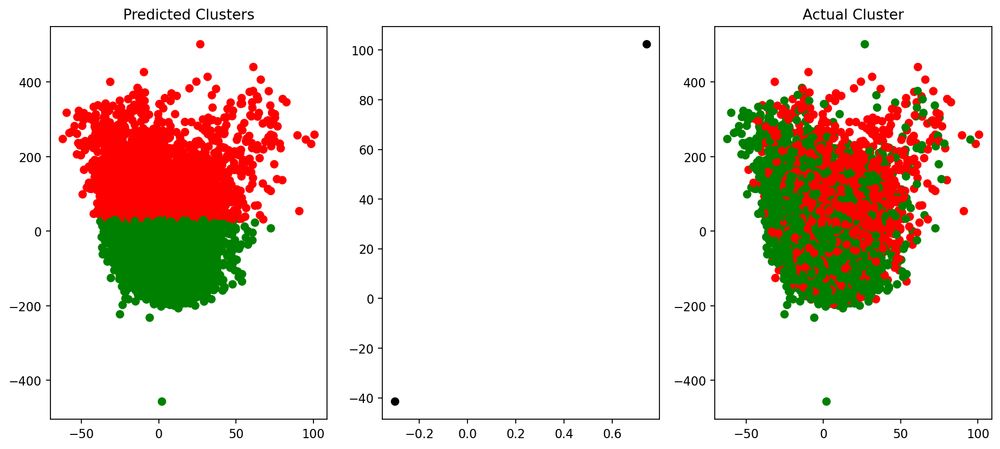

In [325]:
import matplotlib.pyplot as plt
colors = ["green","red"]

fig = plt.figure(figsize=(14, 6), dpi=160)
ax = fig.add_subplot(1,3,1)
ax1 = fig.add_subplot(1,3,2)
ax2 = fig.add_subplot(1,3,3)

#map the colors to the labels
colors_map = list(map(lambda l: colors[l], labels_pred))
ax.set_title("Predicted Clusters")
ax.scatter(X_reduced[:,0], X_reduced[:,1], c=colors_map)

#plot the 3 cluster centres
flat_c= ["black","black"]
C = k_means.cluster_centers_

ax1.scatter(C[:,0], C[:,1], c=flat_c)

#map the encoding to the colors
colors1 = ["green","red"]
colors_orig_map = list(map(lambda l: colors1[l], encoding))

ax2.scatter(X_reduced[:,0], X_reduced[:,1], c=colors_orig_map)
ax2.set_title("Actual Cluster")


plt.show()

# Hierachical evaluation

In [327]:
from sklearn.metrics.cluster import adjusted_rand_score

score_reduced = adjusted_rand_score(val_y, labels_pred)
print("Full features score", score_ARI)
print("Reduced Features score: ", score_reduced)

Full features score 0.09453613918932233
Reduced Features score:  0.07785917879792788


## Cluster labels vs supervised label

In [329]:
# Making the Confusion Matrix
clf_svm.fit(X, y)
supervised_y = clf_svm.predict(val_X)

array([[1597, 7249],
       [2799, 3658]], dtype=int64)

In [330]:
# Confusion Matrix
cm = confusion_matrix(supervised_y, y_kmeans)

print(cm)

[[1597 7249]
 [2799 3658]]


In [332]:
print(classification_report(supervised_y, y_kmeans))

              precision    recall  f1-score   support

         0.0       0.36      0.18      0.24      8846
         1.0       0.34      0.57      0.42      6457

    accuracy                           0.34     15303
   macro avg       0.35      0.37      0.33     15303
weighted avg       0.35      0.34      0.32     15303

